In [ ]:
import os
job_cancel_str="scancel " + os.environ['SLURM_JOBID']
os.system(job_cancel_str)

# Imports

In [1]:
# from os import chdir, scandir, makedirs
import matplotlib.pyplot as plt
# from matplotlib.gridspec import GridSpec
import seaborn as sns


from tqdm.notebook import tqdm
from glob import glob

import os

# from itertools import cycle
# from multiprocessing import Pool, cpu_count

import pandas as pd
import numpy as np
import json

from itertools import combinations

In [2]:
to_win = False

mcn_sep =  '/'
def convert_path_to_machine(path):
    spl = path.split(mcn_sep)
    if to_win:
        return os.path.join('R:\\', *spl[spl.index('g-and-n'):])
    else:
        return os.path.join('/sise/assafzar-group/', *spl[spl.index('g-and-n'):])

# Load Channels Zscores

In [3]:
exp_num=4001
all_channels = True

In [4]:
exp_fld = f'/sise/assafzar-group/g-and-n/GenesAndMorph/{exp_num}'
exp_fld = convert_path_to_machine(exp_fld)

channels = os.listdir(exp_fld) 

if 'zscores' in channels:
    channels.remove('zscores')

In [5]:
channels_pths = [os.path.join(exp_fld, channel) for channel in channels]
plates = os.listdir(os.path.join(channels_pths[0], 'zscores'))

if not all_channels:
    out_fld = os.path.join(exp_fld, 'ALL', 'zscores')
    os.makedirs(out_fld, exist_ok=True)

    for plate in plates:
        dfs = [pd.read_csv(os.path.join(ch_pth, 'zscores', plate), index_col=list(range(4))) for ch_pth in channels_pths]
        pd.concat(dfs, axis=1).to_csv(os.path.join(out_fld, plate))
        del dfs

In [96]:
zscores = {
    # '4to1':{'path':f'/storage/users/g-and-n/tabular_models_results/41/ALL/zscores'},
    # '2to1':{'path':f'/storage/users/g-and-n/tabular_models_results/21/ALL/zscores'},
    '5to5':{'path':f'/sise/assafzar-group/g-and-n/tabular_models_results/4001/channel-AGP-DNA-ER-Mito-RNA/zscores'},
    'raw':{'path': f'/sise/assafzar-group/g-and-n/plates/raw_normalized'},
    # '5to5':{'path':f'/storage/users/g-and-n/tabular_models_results/55/ALL/zscores'},
}

# get plate numbers
cur_fld = f'/storage/users/g-and-n/tabular_models_results/41/ALL/'
# cur_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/4001/zscores'

plates = glob(os.path.join(cur_fld, 'zscores', '*'))
# plate_nums = [
#     25579, 25580, 25581, 25583,
#     25891, 25892, 25903, 25911,
#     24646, 24647, 24648, 24651,
#     26724, 26730, 26744, 26745,
#     25993, 25994, 25997, 26002,
#     24638, 24639, 24640, 24641,
#     25904, 25912, 25913, 25914,
#     26767, 26768, 26771, 26772,
#     24514, 24515, 24516, 24517,
#     24656, 24657, 24661, 24663,
#     26681, 26682, 26683, 26684,
#     26666, 26668, 26669, 26786,
#     26702, 26703, 26739, 26748,
#     25689, 25690, 25692, 25724,
#     24652, 24653, 24654, 24655,
#     24756, 24758, 24759, 24773,
#     26640, 26641, 26642, 26643,
#     24684, 24685, 24687, 24688,
#     26685, 26688, 26695, 26705,
#     25925, 25929, 25931, 25935
# ]
# plate_nums = [f'{p}.csv' for p in plate_nums]
# plate_nums = [os.path.split(plate)[-1] for plate in plates]


# load zscores
for model in zscores.keys():
    plates_paths =  [os.path.join(zscores[model]['path'], plate) for plate in plates]
    zscores[model]['all'] = pd.concat([pd.read_csv(pth, index_col=[0, 1, 2, 3]) for pth in plates_paths])
    # if binary_ss:
    #     zscores[model]['all'][(zscores[model]['all']<2) & (zscores[model]['all']>-2)]=0
    #     zscores[model]['all'][(zscores[model]['all']>=2) | (zscores[model]['all']<=-2)]=1


In [134]:
methods[00]['ss'].head()

,Unnamed: 1,Rep_Cnt,SS_2,SS_3,SS_4,SS_5,SS_6,SS_7,SS_8,SS_9
Metadata_broad_sample,,,,,,,,,,
BRD-A00037023-001-05-1,0,4,0.036859,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
BRD-A00051892-001-05-0,0,4,0.016026,0.001603,0.000000,0.000000,0.0,0.0,0.0,0.0
BRD-A00100033-001-04-8,0,8,0.054487,0.019231,0.008814,0.001603,0.0,0.0,0.0,0.0
BRD-A00214921-001-04-2,0,4,0.017628,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
BRD-A00250346-001-05-0,0,4,0.028846,0.001603,0.000000,0.000000,0.0,0.0,0.0,0.0


In [100]:
new_ss = True
ss_val = 'median'
fields ='columns-all-fs'
ss_scores = {}
base_dir= '/sise/assafzar-group/g-and-n'

methods = {
    # 41: '4to1',
    # 21: '2to1',
    # 11: '1to1',
    # 1: 'baseline',
    555: {'name':'5to5','exp_num':'4001', 'z_path':f'{base_dir}/tabular_models_results/4001/','ss_path':f'{base_dir}/tabular_models_results/4001/channel-AGP-DNA-ER-Mito-RNA'},
    0: {'name':'raw','exp_num':'00','z_path':f'{base_dir}/plates/raw_normalized','ss_path':f'{base_dir}/tabular_models_results/00/{fields}'},
    # 55: '5to5',
    # 5: 'baseline-all-fs',
}


if new_ss: 
    if ss_val =='mean':
        filename ='ss-new-scores-mean'
    else:
        filename ='ss-new-scores-median'
else:
    filename ='ss-scores'
ss_scores = {}
methods_names = []

for m in methods.keys():#[41, 21, 11]:
    # method = methods[exp_id]
    # if methods[method]['name'] != 'raw':
    #     exp = methods[method]['exp_id']
    #     channels_pths = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp}/ch*'
    # else:
    
    # methods[method]['ss'] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)
    methods[m]['ss'] = pd.read_csv(os.path.join(methods[m]['ss_path'],f'{filename}.csv'), index_col=[0])
    

# Calculate SS for raw

In [2]:
from hit_finding.metrics import *

In [5]:
exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/4000/'
z_plates = glob(os.path.join(exp_fld, 'zscores', '*'))
z_plates[0]

'/sise/assafzar-group/g-and-n/tabular_models_results/4000/zscores/24596.csv'

In [7]:
plate_number = z_plates[0].split('/')[-1]
plate_number


'24596.csv'

In [8]:
exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/4000/'
trimmed_z_path = os.path.join(exp_fld, 'zscores_trimmed')
os.makedirs(trimmed_z_path)

In [12]:
plate_csv = pd.read_csv(z_plates[0], index_col=[0, 1, 2, 3])

# plate_csv.values[plate_csv.values>z_max] = z_max

In [24]:
bigger = plate_csv>8
bigger.sum().sum()

143

In [29]:
plate_csv[plate_csv>8] = 8
bigger = plate_csv>8
bigger.sum().sum()

0

In [28]:
from tqdm import tqdm

z_plates = glob(os.path.join(exp_fld, 'zscores', '*'))
z_max = 8

for plate_csv_path in tqdm(z_plates):
    plate_csv = pd.read_csv(plate_csv_path, index_col=[0, 1, 2, 3])
    plate_csv[plate_csv>z_max] = z_max
    
    plate_num = plate_csv_path.split('/')[-1]
    plate_csv.to_csv(os.path.join(trimmed_z_path,plate_num))

100%|██████████| 401/401 [01:35<00:00,  4.19it/s]


In [ ]:
plates = glob(os.path.join(exp_fld, '*', 'results', '*'))
plate_idx = 0
plate = plates[plate_idx]
out_fld = os.path.join(exp_fld, 'zscores')
os.makedirs(out_fld, exist_ok=True)
dest = os.path.join(out_fld, os.path.basename(plate))
print(f'Extract pure z-scores for plate {plate}')
load_pure_zscores(plate, by_well=True,
                  index_fields=None,
                  well_index=None,
                  dest=dest)
print('Done!')

In [ ]:
new_ss = False
value = 'mean'
ae_cols_calc = [
    # 'columns', 
    # 'columns-fs',
    'columns-all-fs']
new_ss = True
value = 'median'
for ae_cols in ae_cols_calc:
    print(f'calculating {ae_cols} zscores...')
    cols_pth = convert_path_to_machine(f'/storage/users/g-and-n/plates/{ae_cols}.json')
    cols = json.load(open(cols_pth, 'r'))
    chans = [c for c in cols.keys() if c not in ['GENERAL', 'MIXED']]
    chans

    del cols['GENERAL']

    cols['ALL'] = sum(cols.values(), [])
    
    for k, v in cols.items():
        print(k, len(v))
    
    for chan, c_cols in cols.items():
        print(chan)
    path = f'/sise/assafzar-group/g-and-n/tabular_models_results/00/{ae_cols}'
    os.makedirs(path, exist_ok=True)
    # load_pure_zscores(df[c_cols], f'/sise/assafzar-group/g-and-n/tabular_models_results/00/{ae_cols}', th_range=range(2, 10), abs_zscore=True, cpd_id_fld='Metadata_broad_sample', name=f'{chan}-',new_ss = new_ss, value=value)
    extract_ss_score(zscores['raw']['all'][cols['ALL']], f'/sise/assafzar-group/g-and-n/tabular_models_results/00/{ae_cols}', th_range=range(2, 10), abs_zscore=True, new_ss = new_ss, value=value)

## load zscores

In [9]:
exp_fld = '/sise/assafzar-group/g-and-n/plates/raw_normalized'
# plates = os.listdir('/sise/assafzar-group/g-and-n/tabular_models_results/55/channel AGP-DNA-ER-Mito-RNA/zscores')
plates_paths = [os.path.join(exp_fld, p) for p in plates]
df = pd.concat([pd.read_csv(pth, index_col=[0, 1, 2, 3]) for pth in plates_paths])
df = df.query('Metadata_ASSAY_WELL_ROLE == "treated"').droplevel(1)
# 

In [66]:
zscores = {
    # '4to1':{'path':f'/storage/users/g-and-n/tabular_models_results/41/ALL/zscores'},
    # '2to1':{'path':f'/storage/users/g-and-n/tabular_models_results/21/ALL/zscores'},
    # '5to5':{'path':f'/sise/assafzar-group/g-and-n/tabular_models_results/4001/channel-AGP-DNA-ER-Mito-RNA/zscores'},
    'raw':{'path': f'/sise/assafzar-group/g-and-n/plates/raw_normalized'},
    # '5to5':{'path':f'/storage/users/g-and-n/tabular_models_results/55/ALL/zscores'},
}

# get plate numbers
cur_fld = f'/storage/users/g-and-n/tabular_models_results/41/ALL/'
# cur_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/4001/zscores'

plates = glob(os.path.join(cur_fld, 'zscores', '*'))
# plate_nums = [
#     25579, 25580, 25581, 25583,
#     25891, 25892, 25903, 25911,
#     24646, 24647, 24648, 24651,
#     26724, 26730, 26744, 26745,
#     25993, 25994, 25997, 26002,
#     24638, 24639, 24640, 24641,
#     25904, 25912, 25913, 25914,
#     26767, 26768, 26771, 26772,
#     24514, 24515, 24516, 24517,
#     24656, 24657, 24661, 24663,
#     26681, 26682, 26683, 26684,
#     26666, 26668, 26669, 26786,
#     26702, 26703, 26739, 26748,
#     25689, 25690, 25692, 25724,
#     24652, 24653, 24654, 24655,
#     24756, 24758, 24759, 24773,
#     26640, 26641, 26642, 26643,
#     24684, 24685, 24687, 24688,
#     26685, 26688, 26695, 26705,
#     25925, 25929, 25931, 25935
# ]
# plate_nums = [f'{p}.csv' for p in plate_nums]
# plate_nums = [os.path.split(plate)[-1] for plate in plates]


# load zscores
for model in zscores.keys():
    plates_paths =  [os.path.join(zscores[model]['path'], plate) for plate in plates]
    zscores[model]['all'] = pd.concat([pd.read_csv(pth, index_col=[0, 1, 2, 3]) for pth in plates_paths])
    # if binary_ss:
    #     zscores[model]['all'][(zscores[model]['all']<2) & (zscores[model]['all']>-2)]=0
    #     zscores[model]['all'][(zscores[model]['all']>=2) | (zscores[model]['all']<=-2)]=1


In [71]:
zscores['raw']['all'].head()

Cells_Granularity_10_AGP  \
Plate Metadata_ASSAY_WELL_ROLE Metadata_broad_sample Image_Metadata_Well                             
24277 mock                     DMSO                  a14                                 -0.866811   
                                                     b13                                  0.262142   
                                                     b14                                 -0.487092   
                                                     c11                                 -0.728635   
                                                     c12                                 -0.153871   

                                                                          Cells_Granularity_11_AGP  \
Plate Metadata_ASSAY_WELL_ROLE Metadata_broad_sample Image_Metadata_Well                             
24277 mock                     DMSO                  a14                                 -0.873520   
                                                     b13                                  1.375679   
                                                     b14                                 -0.567850   
                                                     c11                                 -1.120283   
                                                     c12                                 -0.381706   

                                                                          Cells_Granularity_12_AGP  \
Plate Metadata_ASSAY_WELL_ROLE Metadata_broad_sample Image_Metadata_Well                             
24277 mock                     DMSO                  a14                                 -0.516961   
                                                     b13                                 -0.321534   
                                                     b14                                 -0.657888   
                                                     c11                                 -0.681025   
                                                     c12                                 -0.629971   

                                                                          Cells_Granularity_13_AGP  \
Plate Metadata_ASSAY_WELL_ROLE Metadata_broad_sample Image_Metadata_Well                             
24277 mock                     DMSO                  a14                                 -0.133236   
                                                     b13                                 -0.481643   
                                                     b14                                 -0.800876   
                                                     c11                                 -0.897650   
                                                     c12                                 -0.298033   

                                                                          Cells_Granularity_14_AGP  \
Plate Metadata_ASSAY_WELL_ROLE Metadata_broad_sample Image_Metadata_Well                             
24277 mock                     DMSO                  a14                                 -0.320002   
                                                     b13                                 -0.311362   
                                                     b14                                  0.213830   
                                                     c11                                  2.183651   
                                                     c12                                 -0.646708   

                                                                          Cells_Granularity_15_AGP  \
Plate Metadata_ASSAY_WELL_ROLE Metadata_broad_sample Image_Metadata_Well                             
24277 mock                     DMSO                  a14                                 -0.644265   
                                                     b13                                 -0.431985   
                                                     b14                                  0

In [81]:
a = cols['ALL']
b = zscores['raw']['all'].columns

c = np.intersect1d(a,b)
len(a),len(b),len(c)

(529, 414, 414)

In [89]:
new_ss = False
value = 'mean'
ae_cols_calc = [
    # 'columns', 
    'columns-fs',
    'columns-all-fs']
new_ss = True
value = 'median'
for ae_cols in ae_cols_calc:
    print(f'calculating {ae_cols} zscores...')
    cols_pth = convert_path_to_machine(f'/storage/users/g-and-n/plates/{ae_cols}.json')
    cols = json.load(open(cols_pth, 'r'))
    chans = [c for c in cols.keys() if c not in ['GENERAL', 'MIXED']]
    chans

    del cols['GENERAL']

    cols['ALL'] = sum(cols.values(), [])
    
    for k, v in cols.items():
        print(k, len(v))
    
    for chan, c_cols in cols.items():
        print(chan)
    path = f'/sise/assafzar-group/g-and-n/tabular_models_results/00/{ae_cols}'
    os.makedirs(path, exist_ok=True)
    # load_pure_zscores(df[c_cols], f'/sise/assafzar-group/g-and-n/tabular_models_results/00/{ae_cols}', th_range=range(2, 10), abs_zscore=True, cpd_id_fld='Metadata_broad_sample', name=f'{chan}-',new_ss = new_ss, value=value)
    extract_ss_score(zscores['raw']['all'][cols['ALL']], f'/sise/assafzar-group/g-and-n/tabular_models_results/00/{ae_cols}', th_range=range(2, 10), abs_zscore=True, new_ss = new_ss, value=value)

calculating columns-fs zscores...
AGP 31
DNA 34
ER 35
Mito 34
RNA 35
ALL 169
AGP
DNA
ER
Mito
RNA
ALL
calc with median
saved to /sise/assafzar-group/g-and-n/tabular_models_results/00/columns-fs
calculating columns-all-fs zscores...
AGP 33
DNA 33
ER 31
Mito 31
RNA 28
ALL 156
AGP
DNA
ER
Mito
RNA
ALL
calc with median
saved to /sise/assafzar-group/g-and-n/tabular_models_results/00/columns-all-fs


In [12]:
cols_pth = convert_path_to_machine('/storage/users/g-and-n/plates/columns-fs.json')
cols = json.load(open(cols_pth, 'r'))
chans = [c for c in cols.keys() if c not in ['GENERAL', 'MIXED']]
chans

del cols['GENERAL']

cols['ALL'] = sum(cols.values(), [])

In [13]:
for k, v in cols.items():
    print(k, len(v))

AGP 31
DNA 34
ER 35
Mito 34
RNA 35
ALL 169


#### 5to5

In [37]:
exp_fld = '/sise/assafzar-group/g-and-n/tabular_models_results/55'
plates_paths = glob(os.path.join(exp_fld, 'channel AGP-DNA-ER-Mito-RNA', 'zscores', '*'))
df = pd.concat([pd.read_csv(pth, index_col=[0, 1, 2, 3]) for pth in plates_paths])
df = df.query('Metadata_ASSAY_WELL_ROLE == "treated"').droplevel(1)
# 

In [ ]:
for chan, c_cols in cols.items():
    print(chan)
    extract_ss_score(df[c_cols], '/sise/assafzar-group/g-and-n/tabular_models_results/55', th_range=range(2, 21), cpd_id_fld='Metadata_broad_sample', name=f'{chan}-')

# Merge results from different channels

# Analyze 2 -> 1

channels_inout = [
    (['AGP'], ['DNA', 'Mito']),
    (['AGP'], ['DNA', 'RNA']),
    (['AGP'], ['ER', 'Mito']),
    (['AGP'], ['ER', 'RNA']),
    (['DNA'], ['AGP', 'Mito']),
    (['DNA'], ['AGP', 'RNA']),
    (['ER'], ['AGP', 'Mito']),
    (['ER'], ['AGP', 'RNA']),
    (['Mito'], ['AGP', 'DNA']),
    (['Mito'], ['AGP', 'ER']),
    (['RNA'], ['AGP', 'DNA']),
    (['RNA'], ['AGP', 'ER']),
    (['AGP'], ['DNA', 'ER']),
    (['AGP'], ['Mito', 'RNA']),
]

In [17]:
channels_inout = [
    (['AGP'], ['Mito', 'RNA']),
    (['DNA'], ['AGP', 'Mito']),
    (['ER'], ['AGP', 'RNA']),
    (['Mito'], ['AGP', 'ER']),
    (['RNA'], ['AGP', 'ER']),
]

In [26]:
dfs_pths = [f'/sise/assafzar-group/g-and-n/tabular_models_results/21/channel {c}/results.csv' for ((c,),_) in channels_inout]
dfs_pths = [convert_path_to_machine(pth) for pth in dfs_pths]
dfs = [pd.read_csv(pth, dtype={'Plate':str}) for pth in dfs_pths]
len(dfs)

5

In [28]:
pth = '/sise/assafzar-group/g-and-n/tabular_models_results/4001/channel-AGP-DNA-ER-Mito-RNA/results.csv'
df = pd.read_csv(pth)

EmptyDataError: No columns to parse from file

In [19]:
metrics = dfs[0].columns[3:]
list(metrics)

['MSE', 'PCC']

In [21]:
dfs

[    Dataset  Plate   Subset       MSE       PCC
 0     train    NaN      NaN  0.434645  0.740737
 1       val    NaN      NaN  0.447155  0.740380
 2      test  24596     mock  0.371329  0.760639
 3      test  24596  treated  0.368189  0.760376
 4      test  26679     mock  0.384270  0.741984
 ..      ...    ...      ...       ...       ...
 807    test  26563     mock  0.421403  0.738806
 808    test  26563  treated  0.445666  0.724618
 809    test  25408  treated  0.762367  0.662885
 810    test  26563     mock  0.421403  0.738806
 811    test  26563  treated  0.445666  0.724618
 
 [812 rows x 5 columns],
     Dataset  Plate   Subset       MSE       PCC
 0     train    NaN      NaN  0.105698  0.796849
 1       val    NaN      NaN  0.125351  0.791479
 2      test  24596     mock  0.070774  0.830372
 3      test  24596  treated  0.066235  0.838473
 4      test  26679     mock  0.089774  0.784805
 ..      ...    ...      ...       ...       ...
 807    test  26563     mock  0.099663  0.

## Violin plot distribution

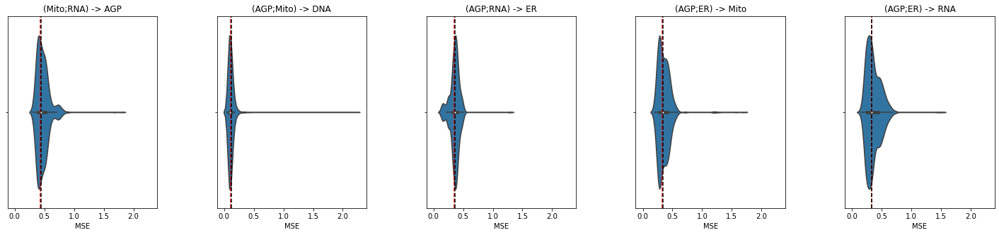

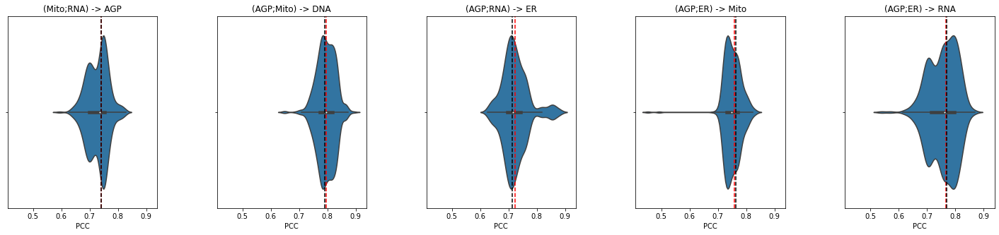

In [7]:
ncol = 5
nrow = len(dfs)//ncol

for metric in metrics:
    # d={'xlabel':"features Z-score", 'ylabel':"mapping Z-score"}
    d = {}
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5,nrow*5), sharey=True, sharex=True, subplot_kw=d)
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    # fig.suptitle(f'Comapring Z-score - raw features vs. mappings', fontsize = 24)

    for i, df in enumerate(dfs):
        ax = axs[i]
        ax = sns.violinplot(x=df[df['Dataset'] == 'test'][metric], ax=ax)
        ax.axvline(df.iloc[0][metric], color='r', linestyle='--')
        ax.axvline(df.iloc[1][metric], color='k', linestyle='--')
    #     ax.set_yscale('symlog', base=10)
    #     ax.set_xscale('symlog', base=10)
    #     ax.set(xlim=(0, 40), ylim=(0, 40))

        out_chans, in_chans = channels_inout[i]

        ax.set_title(f'({";".join(in_chans)}) -> {out_chans[0]}')
    #     ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
    #                      bottom=True, top=False, left=True, right=False)

## Plot Bar Plot

### Create dataframe copy woth model name

In [19]:
dfs_copy = [df.copy() for df in dfs]

In [20]:
for i, df in enumerate(dfs_copy):
    out_chans, in_chans = channels_inout[i]
    df['Model'] = f'({";".join(in_chans)}) -> {out_chans[0]}'

In [21]:
all_dfs = pd.concat(dfs_copy)
all_dfs['Dataset'] = all_dfs['Dataset'].apply(lambda x: x+'-' if x=='test' else x) + all_dfs['Subset'].apply(lambda x: '' if x is np.nan else x)

### Melt dataframe and plot

In [22]:
agg_melt = all_dfs.melt(id_vars=['Model', 'Dataset'], value_vars=metrics, var_name='Metric_Name', value_name='Metric_Value')

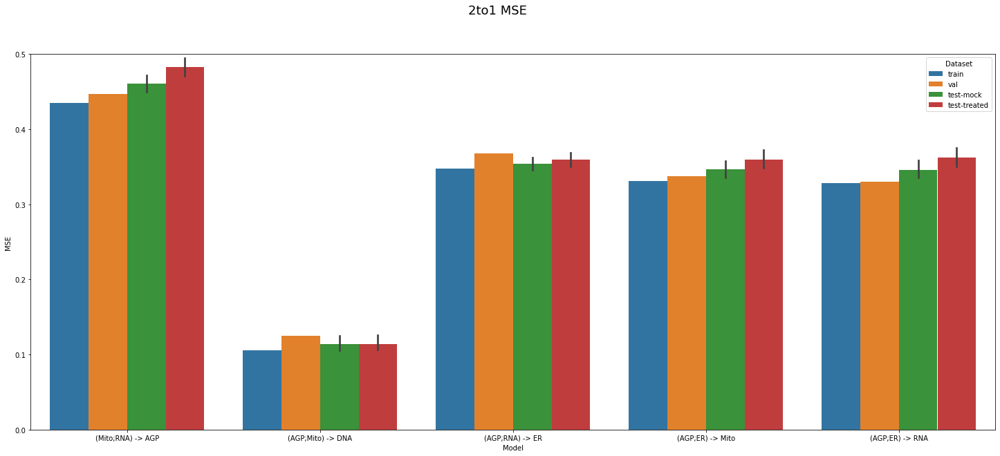

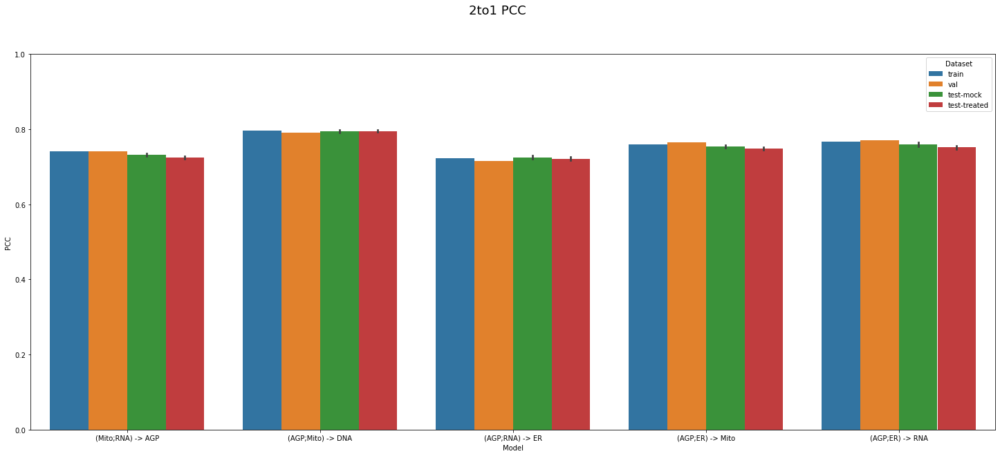

In [23]:
ylim_up = 0.5
for metric in metrics:
    fig, axs = plt.subplots(figsize=(25,10), facecolor='white')
    fig.suptitle(f'2to1 {metric}', fontsize = 18)
    _ = sns.barplot(data=agg_melt[agg_melt['Metric_Name']==metric], x='Model', y='Metric_Value', hue='Dataset', ax=axs)
    _ = axs.set_ylabel(metric)
    _ = axs.set(ylim=(0, ylim_up))
    ylim_up += 0.5

# Evaluate 4 -> 1

## Load Results

In [24]:
channels_pths = '/sise/assafzar-group/g-and-n/tabular_models_results/41/channel '
channels_pths = [convert_path_to_machine(channels_pths) + c for c in ['AGP', 'DNA', 'ER', 'Mito', 'RNA']]
channels_names = [p.split(' ')[-1] for p in channels_pths]
res_pths = [os.path.join(chan_pth, 'results.csv') for chan_pth in channels_pths]
dfs = [pd.read_csv(pth, dtype={'Plate':str}) for pth in res_pths]
len(dfs)

5

In [33]:
metrics = dfs[0].columns[3:]
list(metrics)

['MSE', 'PCC']

## Violin plot distribution

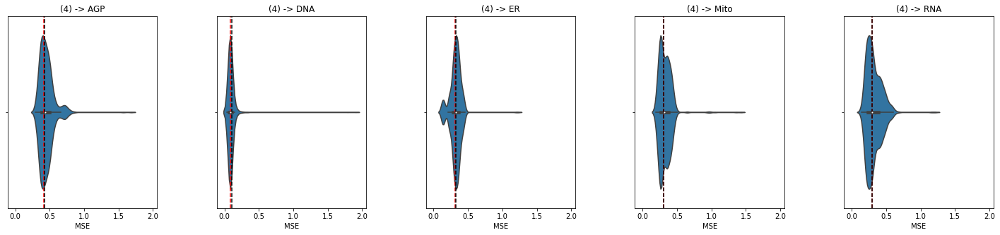

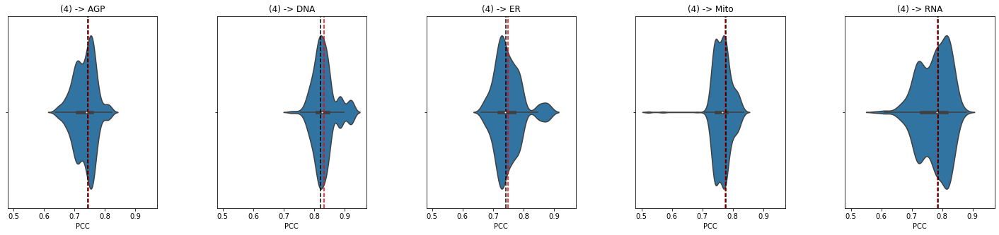

In [30]:
ncol = 5
nrow = len(dfs)//ncol

for metric in metrics:
    # d={'xlabel':"features Z-score", 'ylabel':"mapping Z-score"}
    d = {}
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5,nrow*5), sharey=True, sharex=True, subplot_kw=d)
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    # fig.suptitle(f'Comapring Z-score - raw features vs. mappings', fontsize = 24)

    for i, (chan_name, df) in enumerate(zip(channels_names, dfs)):
        ax = axs[i]
        ax = sns.violinplot(x=df[df['Dataset'] == 'test'][metric], ax=ax)
        ax.axvline(df.iloc[0][metric], color='r', linestyle='--')
        ax.axvline(df.iloc[1][metric], color='k', linestyle='--')
    #     ax.set_yscale('symlog', base=10)
    #     ax.set_xscale('symlog', base=10)
    #     ax.set(xlim=(0, 40), ylim=(0, 40))

        ax.set_title(f'({4}) -> {chan_name}')
    #     ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
    #                      bottom=True, top=False, left=True, right=False)

## Plot Bar Plot

### Create dataframe copy woth model name

In [25]:
dfs_copy = [df.copy() for df in dfs]

In [26]:
for chan_name, df in zip(channels_names, dfs_copy):
    df['Model'] = f'({4}) -> {chan_name}'

In [27]:
all_dfs = pd.concat(dfs_copy)
all_dfs['Dataset'] = all_dfs['Dataset'].apply(lambda x: x+'-' if x=='test' else x) + all_dfs['Subset'].apply(lambda x: '' if x is np.nan else x)

### Melt dataframe and plot

In [28]:
agg_melt = all_dfs.melt(id_vars=['Model', 'Dataset'], value_vars=metrics, var_name='Metric_Name', value_name='Metric_Value')

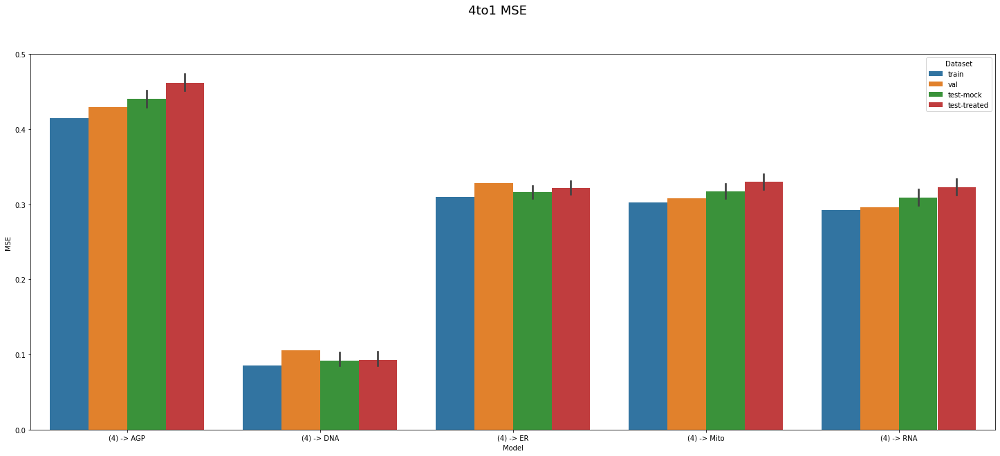

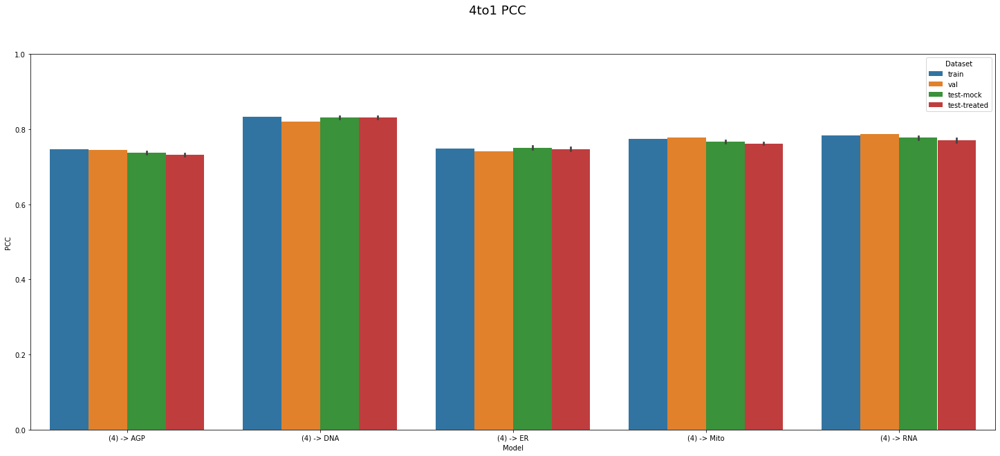

In [29]:
ylim_up = 0.5
for metric in metrics:
    fig, axs = plt.subplots(figsize=(25,10), facecolor='white')
    fig.suptitle(f'4to1 {metric}', fontsize = 18)
    _ = sns.barplot(data=agg_melt[agg_melt['Metric_Name']==metric], x='Model', y='Metric_Value', hue='Dataset', ax=axs)
    _ = axs.set_ylabel(metric)
    _ = axs.set(ylim=(0, ylim_up))
    ylim_up += 0.5

# Evaluate 1 -> 1

## Load Results

In [30]:
channels_pths = '/sise/assafzar-group/g-and-n/tabular_models_results/11/channel '
channels_pths = [convert_path_to_machine(channels_pths) + c for c in ['AGP', 'DNA', 'ER', 'Mito', 'RNA']]
channels_names = [p.split(' ')[-1] for p in channels_pths]
res_pths = [os.path.join(chan_pth, 'results.csv') for chan_pth in channels_pths]
dfs = [pd.read_csv(pth, dtype={'Plate':str}) for pth in res_pths]
len(dfs)

5

In [5]:
metrics = dfs[0].columns[3:]
list(metrics)

['MSE', 'PCC']

## Violin plot distribution

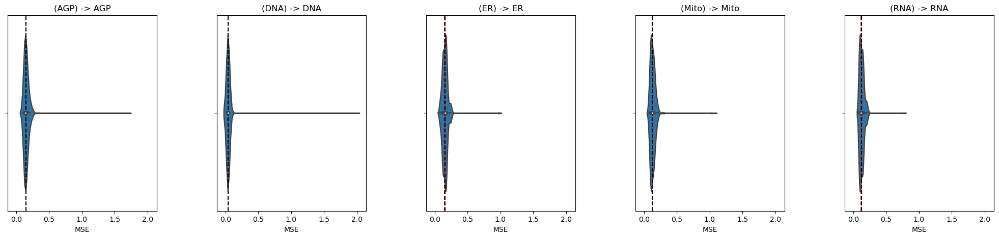

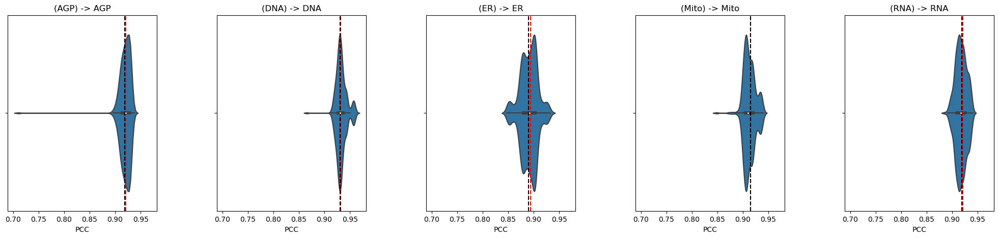

In [44]:
ncol = 5
nrow = len(dfs)//ncol

for metric in metrics:
    # d={'xlabel':"features Z-score", 'ylabel':"mapping Z-score"}
    d = {}
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5,nrow*5), sharey=True, sharex=True, subplot_kw=d)
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    # fig.suptitle(f'Comapring Z-score - raw features vs. mappings', fontsize = 24)

    for i, (chan_name, df) in enumerate(zip(channels_names, dfs)):
        ax = axs[i]
        ax = sns.violinplot(x=df[df['Dataset'] == 'test'][metric], ax=ax)
        ax.axvline(df.iloc[0][metric], color='r', linestyle='--')
        ax.axvline(df.iloc[1][metric], color='k', linestyle='--')
    #     ax.set_yscale('symlog', base=10)
    #     ax.set_xscale('symlog', base=10)
    #     ax.set(xlim=(0, 40), ylim=(0, 40))

        ax.set_title(f'({chan_name}) -> {chan_name}')
    #     ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
    #                      bottom=True, top=False, left=True, right=False)

## Plot Bar Plot

### Create dataframe copy woth model name

In [31]:
dfs_copy = [df.copy() for df in dfs]

In [32]:
for chan_name, df in zip(channels_names, dfs_copy):
    df['Model'] = f'({chan_name}) -> {chan_name}'

In [33]:
all_dfs = pd.concat(dfs_copy)
all_dfs['Dataset'] = all_dfs['Dataset'].apply(lambda x: x+'-' if x=='test' else x) + all_dfs['Subset'].apply(lambda x: '' if x is np.nan else x)

### Melt dataframe and plot

In [34]:
agg_melt = all_dfs.melt(id_vars=['Model', 'Dataset'], value_vars=metrics, var_name='Metric_Name', value_name='Metric_Value')

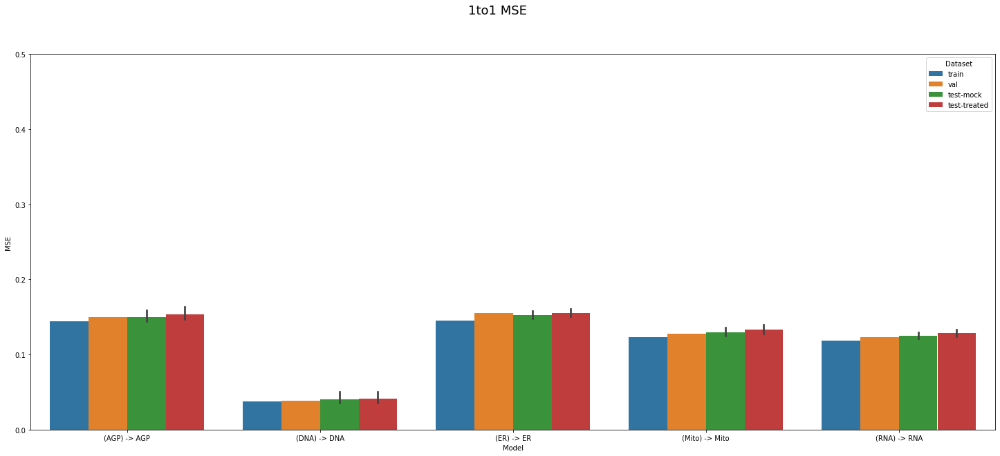

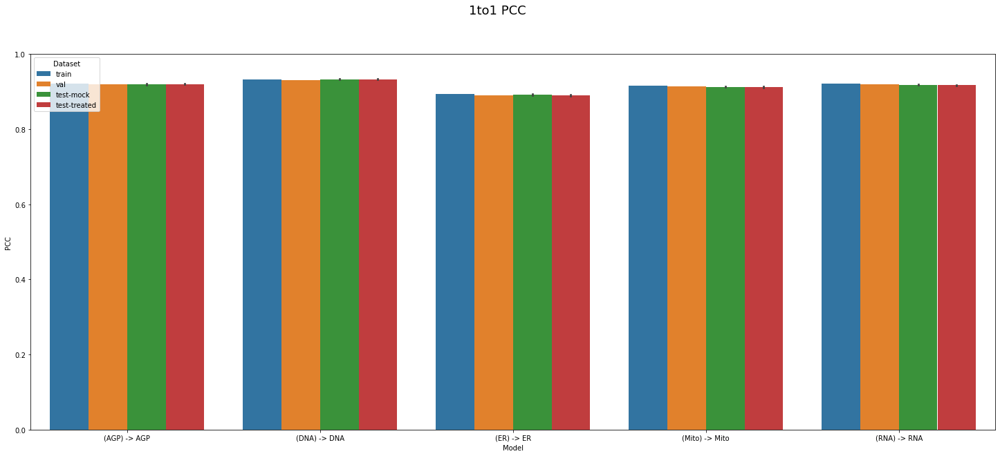

In [35]:
ylim_up = 0.5
for metric in metrics:
    fig, axs = plt.subplots(figsize=(25,10), facecolor='white')
    fig.suptitle(f'1to1 {metric}', fontsize = 18)
    _ = sns.barplot(data=agg_melt[agg_melt['Metric_Name']==metric], x='Model', y='Metric_Value', hue='Dataset', ax=axs)
    _ = axs.set_ylabel(metric)
    _ = axs.set(ylim=(0, ylim_up))
    ylim_up += 0.5

# Plot ss-scores

## Load Results

In [3]:

ss_scores = {}

# mtd_names = {
#     41: '4to1',
#     21: '2to1',
#     11: '1to1',
#     1: 'baseline',
#     111: '1to1-fs',
#     0: 'baseline-fs',
#     55: '5to5',
#     5: 'baseline-all-fs',
# }

methods = {
    # 41: '4to1',
    # 21: '2to1',
    # 11: '1to1',
    # 1: 'baseline',
    555: {'name':'1to1','exp_num':4001, 'path':f'/storage/users/g-and-n/tabular_models_results/4001/'},
    0: {'name':'raw','exp_num':0,'path':f'/storage/users/g-and-n/plates/raw_normalized'},
    # 55: '5to5',
    # 5: 'baseline-all-fs',
}

# ss_scores = {
#     # '4to1':{'path':f'/storage/users/g-and-n/tabular_models_results/41/ALL/zscores'},
#     # '2to1':{'path':f'/storage/users/g-and-n/tabular_models_results/21/ALL/zscores'},
#     '5to5':{'path':f'/storage/users/g-and-n/tabular_models_results/4001/'},
#     'raw':{'path': f'/sise/assafzar-group/g-and-n/plates/raw_normalized'},
#     # '5to5':{'path':f'/storage/users/g-and-n/tabular_models_results/55/ALL/zscores'},
# }

if new_ss: 
    if ss_val =='mean':
        filename ='ss-new-scores-mean'
    else:
        filename ='ss-new-scores-median'
else:
    filename ='ss-scores'
ss_scores = {}
methods_names = []
for method in methods.keys():#[41, 21, 11]:
    # method = methods[exp_id]
    methods_names.append(method)
    if methods[method]['name'] != 'raw':
        exp = methods[method]['exp_id']
        channels_pths = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp}/ch*'
    else:
        
        channels_pths = [methods[method][path]
    channels_pths = convert_path_to_machine(os.path.join(exp_fld, 'channel '))
    # channels = ['AGP', 'DNA', 'ER', 'Mito', 'RNA']
    # channels_pths = [os.path.join(exp_fld, 'ALL')] + [channels_pths + c for c in channels]
    # channels = ['ALL'] + channels
    # res_pths = [os.path.join(chan_pth, f'{filename}.csv') for chan_pth in channels_pths]
    # methods[method]['ss'] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)
    methods[method]['ss'] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)
    
        
        

# ss_scores = {}
# for exp_id in [111,11]:#[41, 21, 11]:
#     exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp_id}'
#     channels_pths = convert_path_to_machine(os.path.join(exp_fld, 'channel '))
#     channels = ['AGP', 'DNA', 'ER', 'Mito', 'RNA']
#     channels_pths = [os.path.join(exp_fld, 'ALL')] + [channels_pths + c for c in channels]
#     channels = ['ALL'] + channels
#     res_pths = [os.path.join(chan_pth, 'ss-scores.csv') for chan_pth in channels_pths]
#     ss_scores[exp_id] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)
    
# for exp_id in [55,0,5]:#[41, 21, 11]:
#     exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp_id}'
#     exp_fld = convert_path_to_machine(exp_fld)
#     # channels = ['ALL', 'AGP', 'DNA', 'ER', 'Mito', 'RNA']
#     res_pths = [os.path.join(exp_fld, f'{chan}-ss-scores.csv') for chan in channels]
#     ss_scores[exp_id] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)

In [4]:
ss_scores[1] = pd.read_csv(f'/storage/users/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/raw.csv', index_col=[0])

for chan, chan_len in [('AGP', 86),('DNA', 70),('ER', 86),('Mito', 86),('RNA', 86),('ALL', 414)]:
    ss_scores[1][ss_scores[1].filter(like=f'{chan}_SS_', axis=1).columns] /= chan_len

In [5]:
mtd_names = {
    41: '4to1',
    21: '2to1',
    11: '1to1',
    1: 'baseline',
    111: '1to1-fs',
    0: 'baseline-fs',
    55: '5to5',
    5: 'baseline-all-fs',
}

In [108]:
combs = [
    (555, 00),
    # (111, 55),
    # (111, 0),
    # (11, 1),
    # (55, 5),
    # (0, 5),
    # (0, 1),
    # (5, 1),
]

#combs = list(combinations(ss_scores.keys(), 2))

## Plot Complementary

In [139]:
def enter_bucket_wrapper(t, th, chan, method_a = 'map',method_b = 'raw1to1'):
    def enter_bucket(sr):
        res = 0
        if len(chan) >0:
            if sr[f'{chan}_SS_{t}_{method_a}'] > th:
                res += 1
            if sr[f'{chan}_SS_{t}_{method_b}'] > th:
                res += 10
        else:
            if sr[f'{chan}SS_{t}_{method_a}'] > th:
                res += 1
            if sr[f'{chan}SS_{t}_{method_b}'] > th:
                res += 10

        

        if res == 1:
            return method_a
        if res == 10:
            return method_b
        if res == 11:
            return 'both'

        return 'none'
    
    return enter_bucket

In [140]:
def plot_complementary(chan, title, cs, method_a = 'map',method_b = 'raw1to1'):
    nrow = 1
    ts = [2,4,6]#[2,6,10,14]
    ncol = len(ts)
#     ylims = [10000, 1200, 700, 550]
    d={'xlabel':"", 'ylabel':"Amount of Hits"}

    fig, ax = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*8,nrow*5), subplot_kw=d, facecolor='white')
    fig.subplots_adjust(hspace=0.4, wspace=0.2)
    fig.suptitle(f'Distributions of hits {title}', fontsize = 32, y = 1)
    
    def get_bar_heights(df, category):
        if category in df.index:
            return df.loc[category]
        
        return np.zeros(df.shape[1])


    for i, t in enumerate(ts):
        # i=t-2
#         counts = pd.concat({f'{th:.1f}': res.apply(enter_bucket_wrapper(t, th * len(cols[chan]), chan), axis=1).value_counts() for th in np.arange(0, 1.01, 0.1)}, axis=1)
        counts = cs[t]

        labels = counts.columns
        width = 0.55      # the width of the bars: can also be len(x) sequence
        
        c_a = get_bar_heights(counts, method_a)
        c_both = get_bar_heights(counts, 'both')
        c_b = get_bar_heights(counts, method_b)

        r1=ax[i].bar(labels, c_a, width, label=method_a)
        r2=ax[i].bar(labels, c_both, width, bottom=c_a, label='both')
        r3=ax[i].bar(labels, c_b, width, bottom=c_a+c_both, label=method_b)
        # ax[i//ncol,i%ncol].bar_label(r1, padding=3)
        ax[i].bar_label(r1,label_type='center')
        ax[i].bar_label(r2,label_type='center')
        ax[i].bar_label(r3,label_type='center',padding=3)

        # ax[i//ncol,i%ncol].set_yscale('symlog', base=10)
        ax[i].set_xlim([1.5,6.5])
        ax[i].set_ylim([0, cs[t].loc[[i for i in cs[t].index if i != 'none'], '0.2'].sum().max()])
        ax[i].set_ylabel('Amount of Hits')
        ax[i].set_title(f'Hits Distribution - Norm-SS({t})', fontsize = 24)
        ax[i].legend()

    fig.tight_layout()
    _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/complementary/{title.replace(".","")}.png', format='png')
    # _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/complementary/{title.replace(".","")}.eps', format='eps')
    plt.show()
    # counts.head()

In [141]:
cs = {}
# channels= ['All']
for mtd_a, mtd_b in combs:
    # for chan in channels:
        # methods[m]['ss']
        # joined = ss_scores[mtd_a].join(ss_scores[mtd_b].filter(like=chan, axis=1), how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
    joined = methods[mtd_a]['ss'].join(methods[mtd_b]['ss'], how='right', lsuffix='_'+methods[mtd_a]['name'], rsuffix='_'+methods[mtd_b]['name'])
    cs[(mtd_a, mtd_b, chan)] = {
        t:
        # pd.concat({f'{th:.1f}': joined.apply(enter_bucket_wrapper(t, th, chan, method_a=mtd_names[mtd_a],method_b=mtd_names[mtd_b]), axis=1).value_counts()
        pd.concat({f'{th:.1f}': joined.apply(enter_bucket_wrapper(t, th,'', method_a=methods[mtd_a]['name'],method_b=methods[mtd_b]['name']), axis=1).value_counts()
                   for th in np.arange(0, 1.01, 0.1)}, axis=1).fillna(0)
        for t in [2,4,6]}#[2,6,10,14]}

    break # Only ALL channel

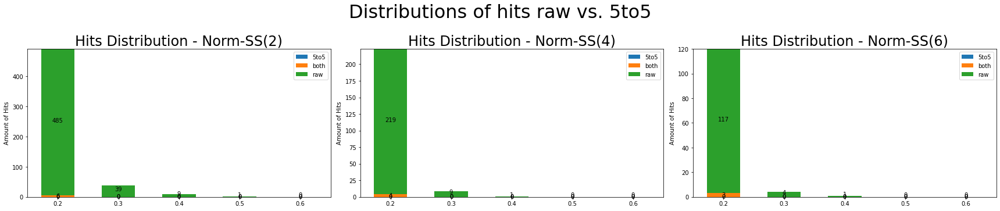

In [148]:
for (mtd_a, mtd_b, chan), cur_cs in cs.items():
    try:
        # plot_complementary(chan, f'{methods[mtd_a]['name']} vs. {methods[mtd_b]['name']} - All', cur_cs, method_a=methods[mtd_a]['name'],method_b=methods[mtd_b]['name'])
        plot_complementary(chan, 'raw vs. 5to5', cur_cs, method_a=methods[mtd_a]['name'],method_b=methods[mtd_b]['name'])
    except:
        print('Problem with', 'raw vs. 5to5')

In [149]:
for (mtd_a, mtd_b, chan), cur_cs in cs.items():
    plot_complementary(chan, f'{mtd_names[mtd_a]} vs. {mtd_names[mtd_b]} - {chan}', cur_cs, method_a=mtd_names[mtd_a],method_b=mtd_names[mtd_b])

NameError: name 'mtd_names' is not defined

## Plot Sensitivity

### Plot scater on diagonal - not operative

In [150]:
# https://stackoverflow.com/questions/22104256/does-matplotlib-have-a-function-for-drawing-diagonal-lines-in-axis-coordinates
def add_identity(axes, *line_args, **line_kwargs):
    identity, = axes.plot([], [], *line_args, **line_kwargs)
    def callback(axes):
        low_x, high_x = axes.get_xlim()
        low_y, high_y = axes.get_ylim()
        low = max(low_x, low_y)
        high = min(high_x, high_y)
        identity.set_data([low, high], [low, high])
    callback(axes)
    axes.callbacks.connect('xlim_changed', callback)
    axes.callbacks.connect('ylim_changed', callback)
    return axes

In [151]:
ts = [2,4,6]
nrow = 3
ncol = len(ts)*(len(channels)//nrow)


for mtd_a, mtd_b in combs:
    d={'xlabel':f'{mtd_names[mtd_b]} (SS)', 'ylabel': f'{mtd_names[mtd_a]} (SS)'}
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.3,nrow*5), subplot_kw=d, facecolor='white')
    fig.suptitle(f'Sensitivity Analysis - {mtd_names[mtd_a]} vs. {mtd_names[mtd_b]}', fontsize = 24)
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    
    for i, chan in enumerate(channels):
        joined = ss_scores[mtd_a].join(ss_scores[mtd_b].filter(like=chan, axis=1), how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')

        for j, t in enumerate(ts):
            ax = axs[i%nrow,(i//nrow)*nrow + j]
            ax.set_title(f'{chan} - Z>{t}')

            _ = sns.scatterplot(data=joined, x=f'{chan}_SS_{t}_{mtd_names[mtd_b]}', y=f'{chan}_SS_{t}_{mtd_names[mtd_a]}', alpha=0.6, ax=ax)


            add_identity(ax, color='r', ls=':')


            ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
                             bottom=True, top=False, left=True, right=False)
            ax.tick_params(axis='both', labelsize = 9)
            ax.yaxis.label.set_size(15)
            ax.xaxis.label.set_size(15)
            ax.title.set_size(20)

            ax.set(xlim=(-0.01, 1), ylim=(-0.01, 1))
            
    plt.show()
        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

#         _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/plots/ss-raw-map-no-abs-several-ts.png', format='png')

NameError: name 'mtd_names' is not defined

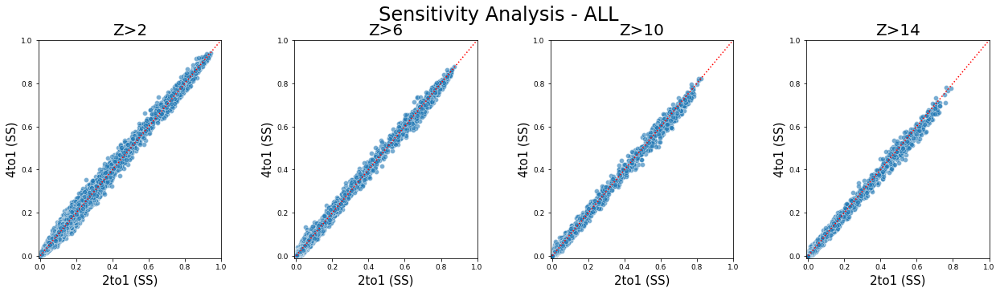

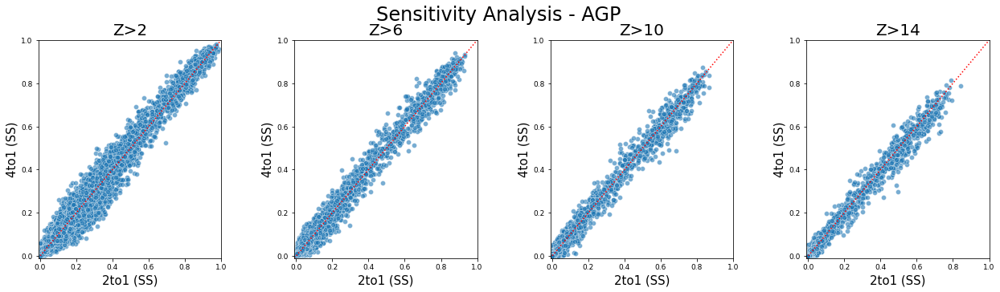

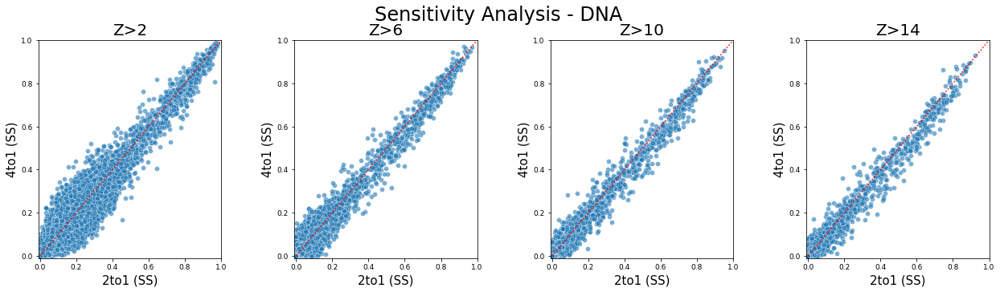

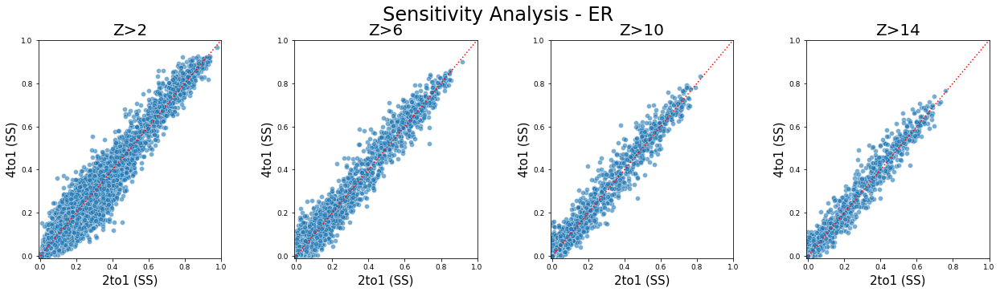

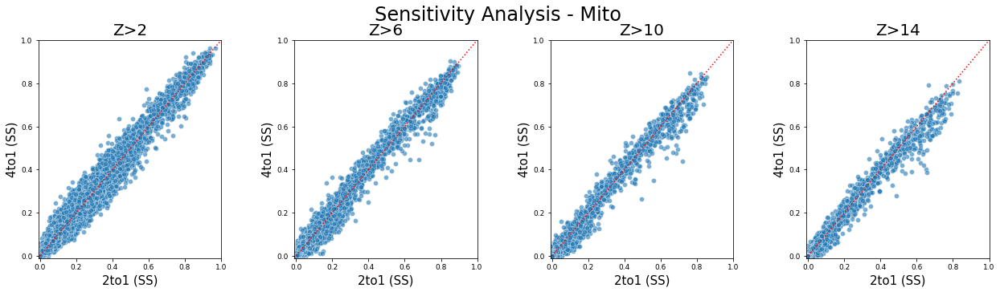

...

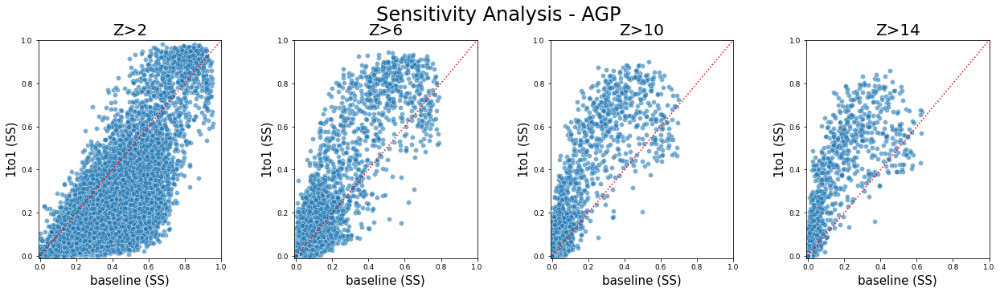

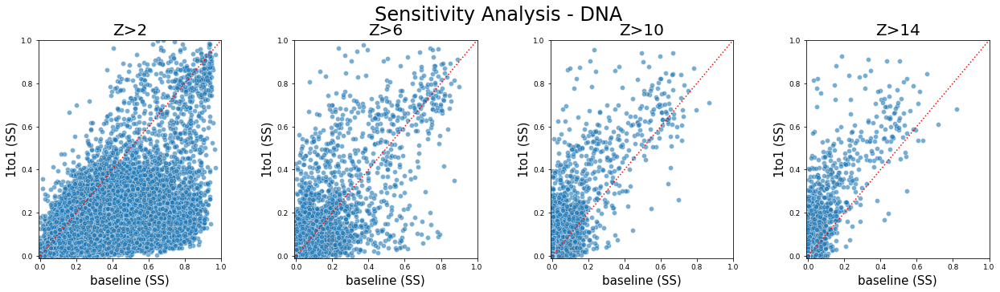

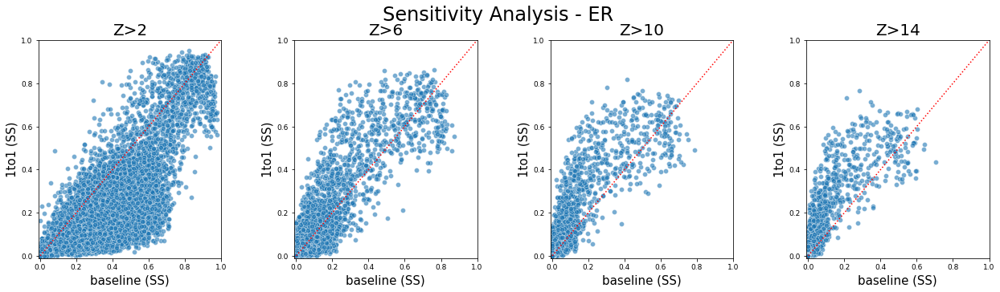

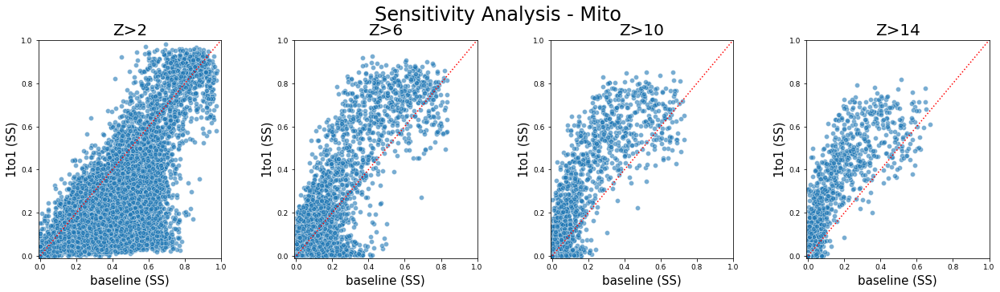

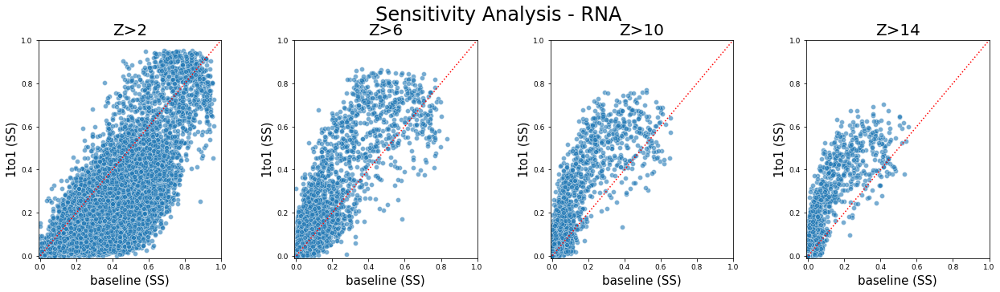

In [16]:
nrow = 1
ncol = 4
ts = [2,6,10,14]

for mtd_a, mtd_b in combinations(ss_scores.keys(), 2):
    d={'xlabel':f'{mtd_names[mtd_b]} (SS)', 'ylabel': f'{mtd_names[mtd_a]} (SS)'}
    for chan in channels:
        joined = ss_scores[mtd_a].join(ss_scores[mtd_b].filter(like=chan, axis=1), how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
        joined = joined / len(cols[chan])

        fig, ax = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.3,nrow*5), subplot_kw=d, facecolor='white')
        fig.suptitle(f'Sensitivity Analysis - {chan}', fontsize = 24, y = 1)
        fig.subplots_adjust(hspace=0.4, wspace=0.4)

        for i, t in enumerate(ts):
            ax[i].set_title(f'Z>{t}')

            _ = sns.scatterplot(data=joined, x=f'{chan}_SS_{t}_{mtd_names[mtd_b]}', y=f'{chan}_SS_{t}_{mtd_names[mtd_a]}', alpha=0.6, ax=ax[i])


            add_identity(ax[i], color='r', ls=':')


            ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
                             bottom=True, top=False, left=True, right=False)
            ax[i].tick_params(axis='both', labelsize = 9)
            ax[i].yaxis.label.set_size(15)
            ax[i].xaxis.label.set_size(15)
            ax[i].title.set_size(20)

            ax[i].set(xlim=(-0.01, 1), ylim=(-0.01, 1))
            
        plt.show()

        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

#         _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/plots/ss-raw-map-no-abs-several-ts.png', format='png')

### Plot Violin plot

In [157]:
methods.keys()
methods[method]['ss']
methods[method]['ss']

dict_keys([555, 0])

In [162]:
results = []
for method in methods.keys():

    # res = (ss_scores[method].filter(like=f'{chan}_SS', axis=1).rename(lambda x: x.split('_')[-1], axis=1)).melt(var_name='Threshold', value_name='SS')
    res = (methods[method]['ss'].rename(lambda x: x.split('_')[-1], axis=1)).melt(var_name='Threshold', value_name='SS')
    res['Channel'] = 'ALL'
    res['Method'] = method
    results.append(res)

In [163]:
data = pd.concat(results)
data

,Threshold,SS,Channel,Method
0,Unnamed: 1,0.00000,ALL,555
1,Unnamed: 1,0.00000,ALL,555
2,Unnamed: 1,0.00000,ALL,555
3,Unnamed: 1,0.00000,ALL,555
4,Unnamed: 1,0.00000,ALL,555
...,...,...,...,...
304385,9,0.00000,ALL,0
304386,9,0.00000,ALL,0
304387,9,0.00000,ALL,0
304388,9,0.00000,ALL,0


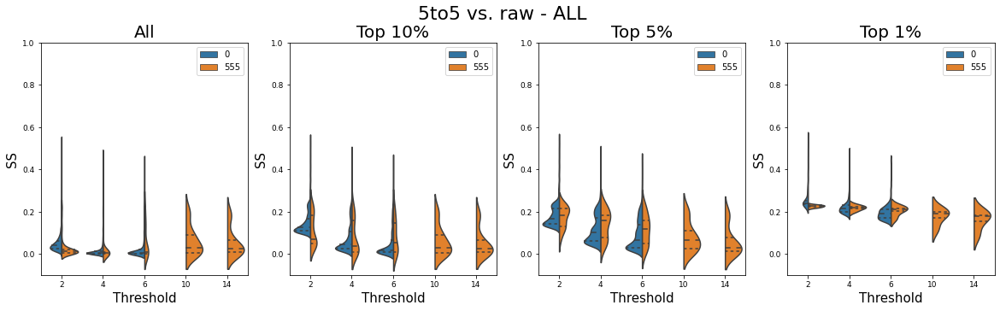

In [167]:
mtd_names={
    00:'raw',
    555:'5to5'}
percentiles = [0,0.9,0.95,0.99]

nrow = 1
ncol = len(percentiles)

d={'xlabel':"Threshold", 'ylabel':"SS"}
titles = ['All', 'Top 10%', 'Top 5%','Top 1%']

chan = 'ALL'




for mtd_a, mtd_b in combs:
    cur_data = data[data.Method.isin([mtd_a,mtd_b])]
    cur_data = cur_data[cur_data.Threshold.isin([str(i) for i in [2, 4, 6, 10, 14]])]
    # cur_data.Method = cur_data.Method.replace(methods.keys())
    # cur_data = cur_data[cur_data.Channel==chan]
    thresholds = cur_data.Threshold.unique()
    methods = cur_data.Method.unique()

    fig, ax = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5,nrow*5), subplot_kw=d, facecolor='white')
    fig.suptitle(f'{mtd_names[mtd_a]} vs. {mtd_names[mtd_b]} - {chan}', fontsize=22, y=1)


    for i, p in enumerate(percentiles):

        data_outliers = pd.DataFrame()
        for t in thresholds:
            data_t = cur_data[cur_data['Threshold']==t]
            for j, m in enumerate(methods):
                # print(m)
                data_m = data_t[data_t['Method']==m]
                # data_m.head()
                quantile = data_m['SS'].quantile(p)
                # print(quantile)
                data_m_outliers = data_m[data_m['SS']>quantile]  
                data_outliers = pd.concat([data_outliers, data_m_outliers])

        # _ = sns.boxplot(data=data_outliers, x='Threshold', y='SS',hue='Method', palette="Set2",ax=ax[i])
        _ = sns.violinplot(data=data_outliers, x='Threshold', y='SS', hue='Method', ax=ax[i], split=True, inner='quartile')
        del data_outliers

        ax[i].set_title(titles[i])
        ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
                         bottom=True, top=False, left=True, right=False)
        ax[i].tick_params(axis='both', labelsize = 9)
        ax[i].yaxis.label.set_size(15)
        ax[i].xaxis.label.set_size(15)
        ax[i].title.set_size(20)
        ax[i].legend(loc='upper right')

        ax[i].set(ylim=(-0.1, 1))
        
    plt.show()
        
    

#     _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]} - ALL.png', format='png')
#     _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]} - ALL.eps', format='eps')


## Plot Sensitivity Difference

### With (0,0)

In [ ]:
diff = {}
ts = range(2,21)
for mtd_a, mtd_b in combinations(ss_scores.keys(), 2):
    joined = ss_scores[mtd_a].join(ss_scores[mtd_b], how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
    for chan in channels:
        diffs = []
        for t in ts:
            met_a = joined[f'{chan}_SS_{t}_{mtd_names[mtd_a]}']
            met_b = joined[f'{chan}_SS_{t}_{mtd_names[mtd_b]}']
            # dif = (met_a - met_b)/len(cols[chan])
            dif.name = t
            diffs.append(dif)
        
        all_diffs = pd.concat(diffs, axis=1)
        all_diffs = all_diffs.melt(var_name='Threshold', value_name='Difference')
        diff[(mtd_a, mtd_b, chan)] = all_diffs

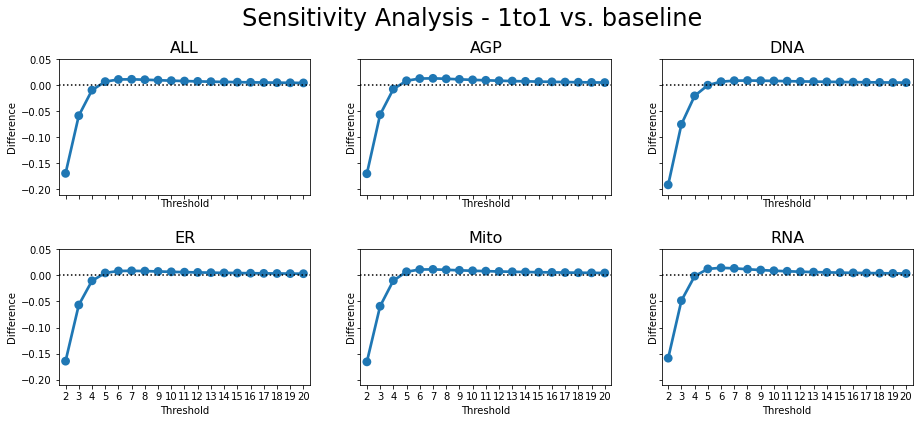

In [29]:
nrow = 2
ncol = 3
d={} #{'xlabel':"same-organelle (SS)", 'ylabel':"organelle-organelle (SS)"}

for mtd_a, mtd_b in combinations(ss_scores.keys(), 2):
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.1,nrow*3), subplot_kw=d, facecolor='white', sharey=True, sharex=True)
    fig.suptitle(f'Sensitivity Analysis - {mtd_names[mtd_a]} vs. {mtd_names[mtd_b]}', fontsize = 24, y = 1)
    fig.subplots_adjust(hspace=0.4, wspace=0.2)

    for i, chan in enumerate(channels):
        ax = axs[i//ncol, i%ncol]
        
        sns.pointplot(data=diff[(mtd_a, mtd_b, chan)], x='Threshold', y='Difference', ax=ax)
        ax.set_title(f'{chan}', fontsize=16)
        ax.axhline(0, linestyle=':', color='k')
        if mtd_b == 1:
            ax.set(ylim=(-0.21, 0.051))
        else:
            ax.set(ylim=(-0.016, 0.011))
        
    plt.show()



#         ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
#                          bottom=True, top=False, left=True, right=False)
#         ax[i].tick_params(axis='both', labelsize = 9)
#         ax[i].yaxis.label.set_size(15)
#         ax[i].xaxis.label.set_size(15)
#         ax[i].title.set_size(20)

        # ax[i].set(xlim=(-0.01, 1), ylim=(-0.01, 1))

        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

#         _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/plots/ss-raw-map-no-abs-several-ts.png', format='png')

### Without (0, 0)

In [13]:
diff_non_zero = {}
ts = range(2,21)
for mtd_a, mtd_b in combs:
    joined = ss_scores[mtd_a].join(ss_scores[mtd_b], how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
    for chan in channels:
        
        
        diffs = []
        for t in ts:
            met_a = joined[f'{chan}_SS_{t}_{mtd_names[mtd_a]}']
            met_b = joined[f'{chan}_SS_{t}_{mtd_names[mtd_b]}']
            mask = (met_a + met_b) != 0
            dif = (met_a - met_b)[mask]#/len(cols[chan])
            dif.name = t
            diffs.append(dif)
        
        all_diffs = pd.concat(diffs, axis=1)
        all_diffs = all_diffs.melt(var_name='Threshold', value_name='Difference')
        diff_non_zero[(mtd_a, mtd_b, chan)] = all_diffs

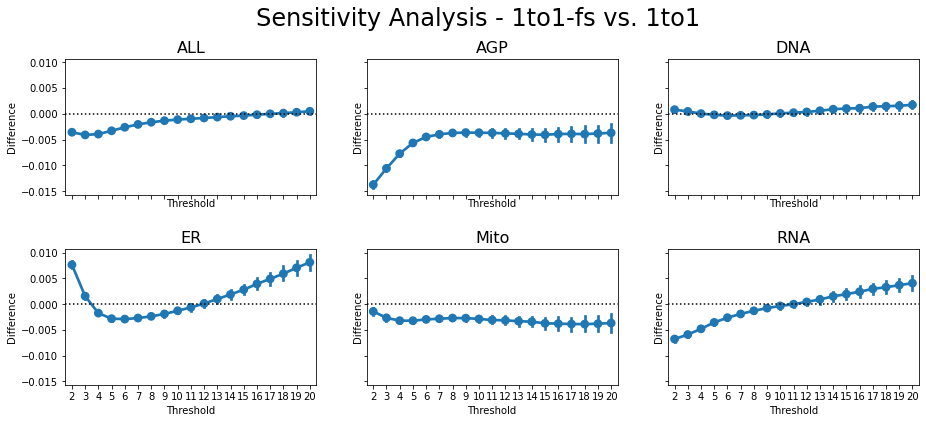

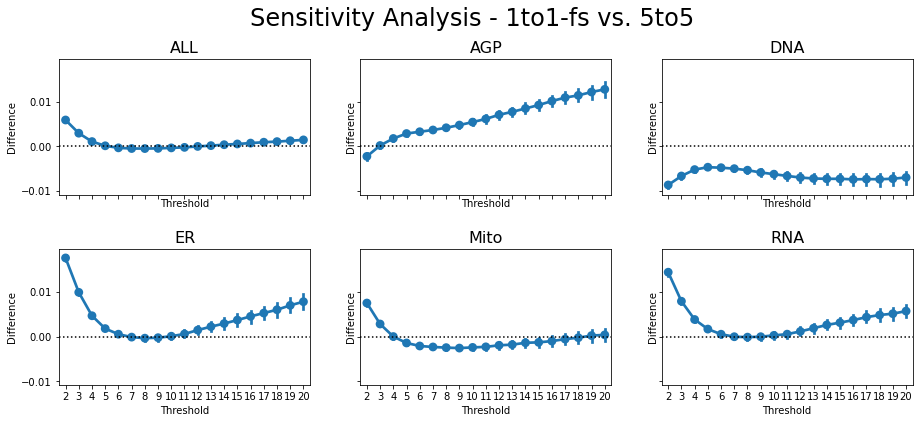

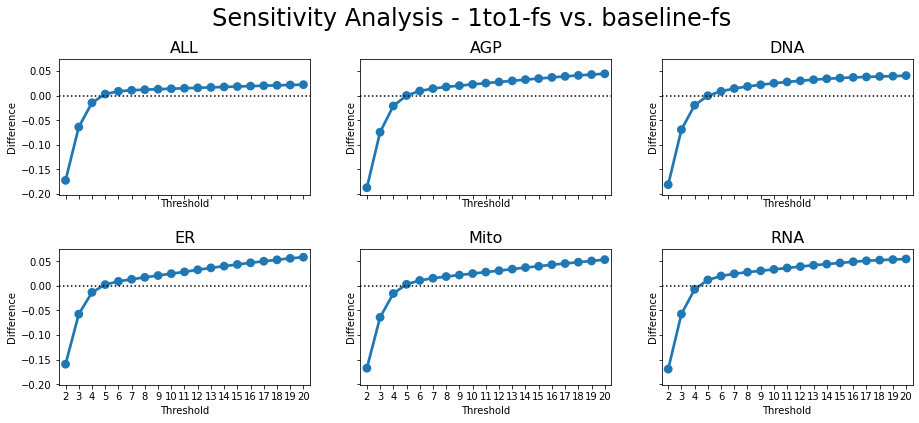

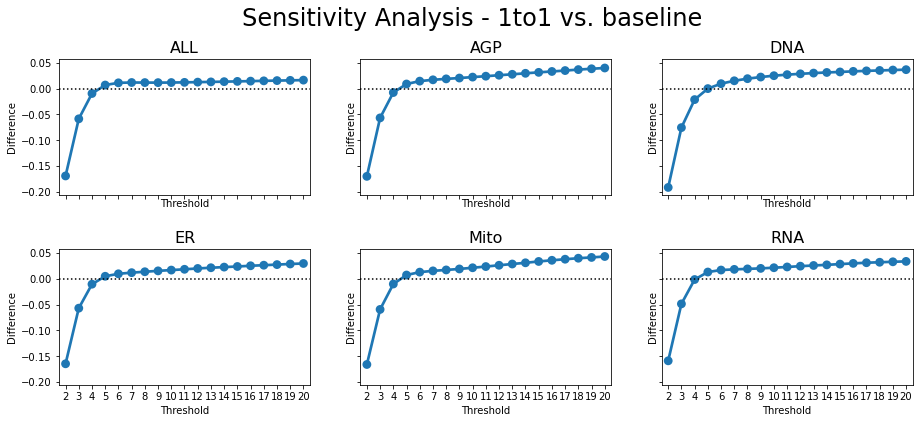

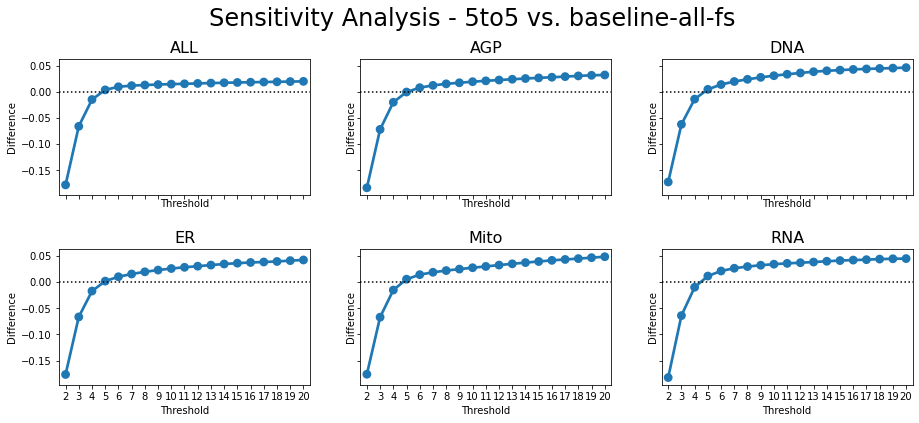

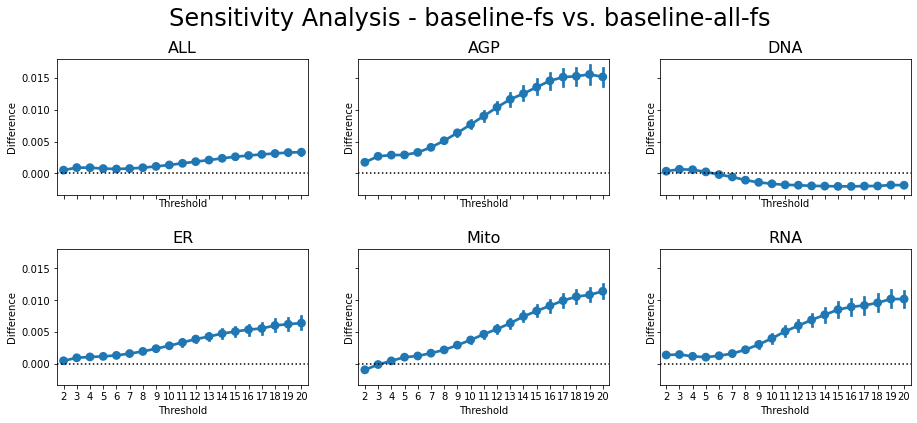

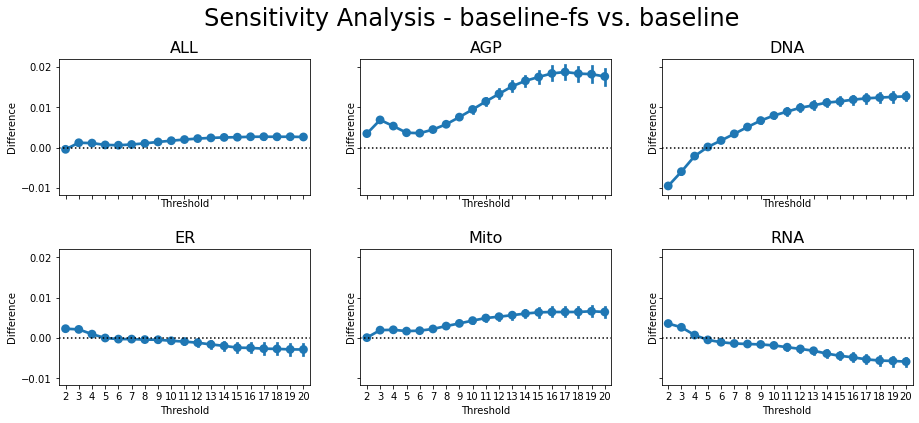

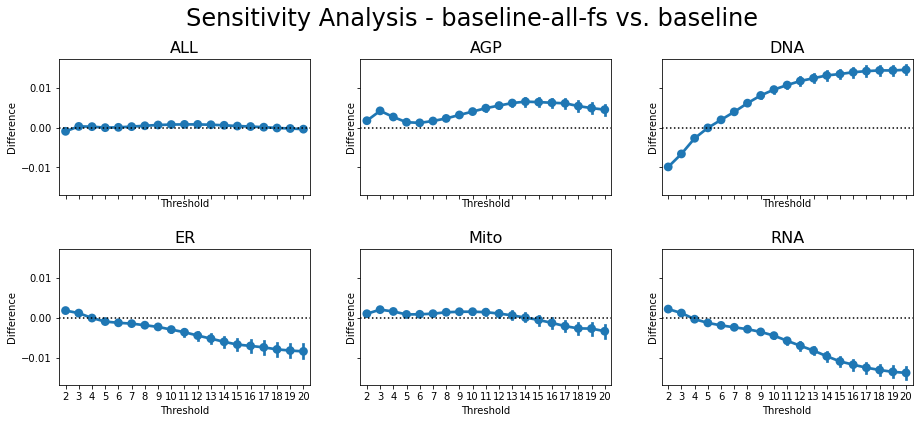

In [14]:
nrow = 2
ncol = 3
d={} #{'xlabel':"same-organelle (SS)", 'ylabel':"organelle-organelle (SS)"}

for mtd_a, mtd_b in combs:
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.1,nrow*3), subplot_kw=d, facecolor='white', sharey=True, sharex=True)
    fig.suptitle(f'Sensitivity Analysis - {mtd_names[mtd_a]} vs. {mtd_names[mtd_b]}', fontsize = 24, y = 1)
    fig.subplots_adjust(hspace=0.4, wspace=0.2)

    for i, chan in enumerate(channels):
        ax = axs[i//ncol, i%ncol]
        
        sns.pointplot(data=diff_non_zero[(mtd_a, mtd_b, chan)], x='Threshold', y='Difference', ax=ax)
        ax.set_title(f'{chan}', fontsize=16)
        ax.axhline(0, linestyle=':', color='k')
        # if mtd_b == 1:
        #     ax.set(ylim=(-0.21, 0.051))
        # else:
        #     ax.set(ylim=(-0.016, 0.011))
        
    plt.show()



#         ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
#                          bottom=True, top=False, left=True, right=False)
#         ax[i].tick_params(axis='both', labelsize = 9)
#         ax[i].yaxis.label.set_size(15)
#         ax[i].xaxis.label.set_size(15)
#         ax[i].title.set_size(20)



        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

    # _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity_diff/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]}.png', format='png')
    # _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity_diff/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]}.eps', format='eps')

In [30]:
channels_pths = '/sise/assafzar-group/g-and-n/tabular_models_results/11/channel '
channels_pths = [convert_path_to_machine(channels_pths) + c for c in ['AGP', 'DNA', 'ER', 'Mito', 'RNA']]
channels_names = [p.split(' ')[-1] for p in channels_pths]
res_pths = [os.path.join(chan_pth, 'results.csv') for chan_pth in channels_pths]
dfs = [pd.read_csv(pth, dtype={'Plate':str}) for pth in res_pths]
len(dfs)

5

In [5]:
metrics = dfs[0].columns[3:]
list(metrics)

['MSE', 'PCC']

## Violin plot distribution

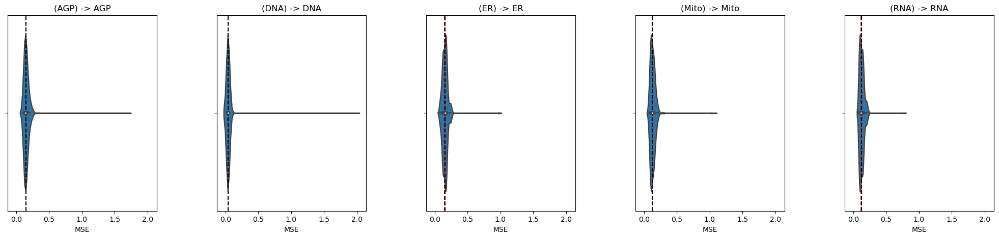

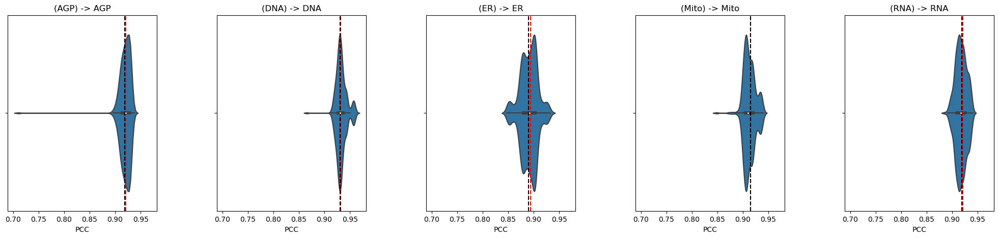

In [44]:
ncol = 5
nrow = len(dfs)//ncol

for metric in metrics:
    # d={'xlabel':"features Z-score", 'ylabel':"mapping Z-score"}
    d = {}
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5,nrow*5), sharey=True, sharex=True, subplot_kw=d)
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    # fig.suptitle(f'Comapring Z-score - raw features vs. mappings', fontsize = 24)

    for i, (chan_name, df) in enumerate(zip(channels_names, dfs)):
        ax = axs[i]
        ax = sns.violinplot(x=df[df['Dataset'] == 'test'][metric], ax=ax)
        ax.axvline(df.iloc[0][metric], color='r', linestyle='--')
        ax.axvline(df.iloc[1][metric], color='k', linestyle='--')
    #     ax.set_yscale('symlog', base=10)
    #     ax.set_xscale('symlog', base=10)
    #     ax.set(xlim=(0, 40), ylim=(0, 40))

        ax.set_title(f'({chan_name}) -> {chan_name}')
    #     ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
    #                      bottom=True, top=False, left=True, right=False)

## Plot Bar Plot

### Create dataframe copy woth model name

In [31]:
dfs_copy = [df.copy() for df in dfs]

In [32]:
for chan_name, df in zip(channels_names, dfs_copy):
    df['Model'] = f'({chan_name}) -> {chan_name}'

In [33]:
all_dfs = pd.concat(dfs_copy)
all_dfs['Dataset'] = all_dfs['Dataset'].apply(lambda x: x+'-' if x=='test' else x) + all_dfs['Subset'].apply(lambda x: '' if x is np.nan else x)

### Melt dataframe and plot

In [34]:
agg_melt = all_dfs.melt(id_vars=['Model', 'Dataset'], value_vars=metrics, var_name='Metric_Name', value_name='Metric_Value')

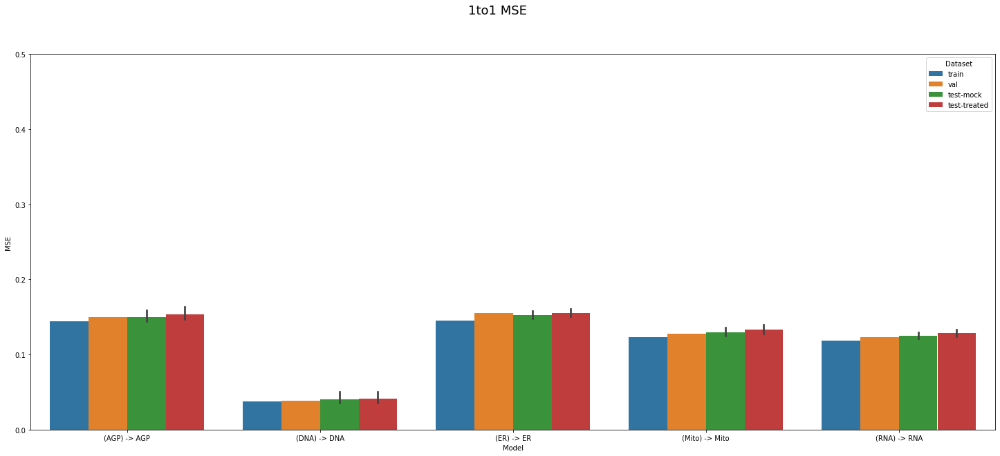

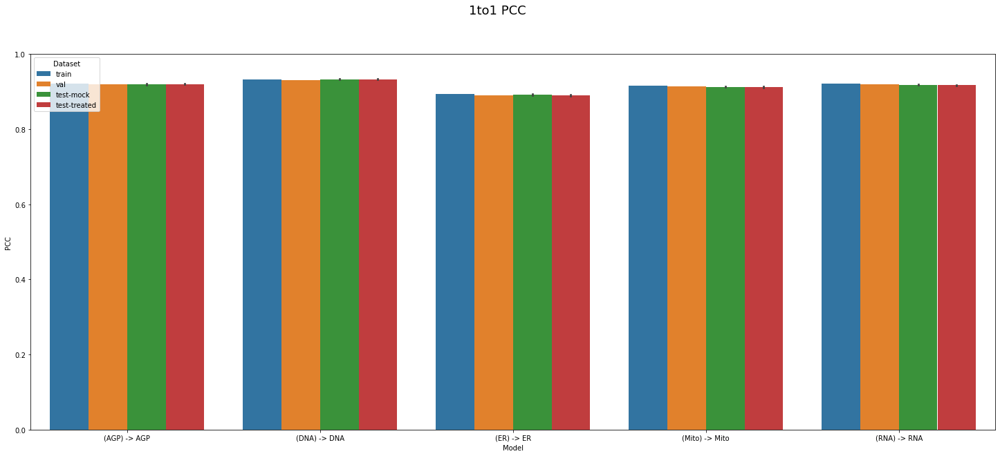

In [35]:
ylim_up = 0.5
for metric in metrics:
    fig, axs = plt.subplots(figsize=(25,10), facecolor='white')
    fig.suptitle(f'1to1 {metric}', fontsize = 18)
    _ = sns.barplot(data=agg_melt[agg_melt['Metric_Name']==metric], x='Model', y='Metric_Value', hue='Dataset', ax=axs)
    _ = axs.set_ylabel(metric)
    _ = axs.set(ylim=(0, ylim_up))
    ylim_up += 0.5

# Plot ss-scores

## Load Results

In [3]:
ss_scores = {}
for exp_id in [111,11]:#[41, 21, 11]:
    exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp_id}'
    channels_pths = convert_path_to_machine(os.path.join(exp_fld, 'channel '))
    channels = ['AGP', 'DNA', 'ER', 'Mito', 'RNA']
    channels_pths = [os.path.join(exp_fld, 'ALL')] + [channels_pths + c for c in channels]
    channels = ['ALL'] + channels
    res_pths = [os.path.join(chan_pth, 'ss-scores.csv') for chan_pth in channels_pths]
    ss_scores[exp_id] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)
    
for exp_id in [55,0,5]:#[41, 21, 11]:
    exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp_id}'
    exp_fld = convert_path_to_machine(exp_fld)
    channels = ['ALL', 'AGP', 'DNA', 'ER', 'Mito', 'RNA']
    res_pths = [os.path.join(exp_fld, f'{chan}-ss-scores.csv') for chan in channels]
    ss_scores[exp_id] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)

In [4]:
ss_scores[1] = pd.read_csv(f'/storage/users/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/raw.csv', index_col=[0])

for chan, chan_len in [('AGP', 86),('DNA', 70),('ER', 86),('Mito', 86),('RNA', 86),('ALL', 414)]:
    ss_scores[1][ss_scores[1].filter(like=f'{chan}_SS_', axis=1).columns] /= chan_len

In [5]:
mtd_names = {
    41: '4to1',
    21: '2to1',
    11: '1to1',
    1: 'baseline',
    111: '1to1-fs',
    0: 'baseline-fs',
    55: '5to5',
    5: 'baseline-all-fs',
}

In [6]:
combs = [
    (111, 11),
    (111, 55),
    (111, 0),
    (11, 1),
    (55, 5),
    (0, 5),
    (0, 1),
    (5, 1),
]

#combs = list(combinations(ss_scores.keys(), 2))

## Plot Complementary

In [15]:
def enter_bucket_wrapper(t, th, chan, method_a = 'map',method_b = 'raw1to1'):
    def enter_bucket(sr):
        res = 0
        if sr[f'{chan}_SS_{t}_{method_a}'] > th:
            res += 1
        if sr[f'{chan}_SS_{t}_{method_b}'] > th:
            res += 10

        if res == 1:
            return method_a
        if res == 10:
            return method_b
        if res == 11:
            return 'both'

        return 'none'
    
    return enter_bucket

In [16]:
def plot_complementary(chan, title, cs, method_a = 'map',method_b = 'raw1to1'):
    nrow = 1
    ts = [2,4,6]#[2,6,10,14]
    ncol = len(ts)
#     ylims = [10000, 1200, 700, 550]
    d={'xlabel':"", 'ylabel':"Amount of Hits"}

    fig, ax = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*8,nrow*5), subplot_kw=d, facecolor='white')
    fig.subplots_adjust(hspace=0.4, wspace=0.2)
    fig.suptitle(f'Distributions of hits {title}', fontsize = 32, y = 1)
    
    def get_bar_heights(df, category):
        if category in df.index:
            return df.loc[category]
        
        return np.zeros(df.shape[1])


    for i, t in enumerate(ts):
        # i=t-2
#         counts = pd.concat({f'{th:.1f}': res.apply(enter_bucket_wrapper(t, th * len(cols[chan]), chan), axis=1).value_counts() for th in np.arange(0, 1.01, 0.1)}, axis=1)
        counts = cs[t]

        labels = counts.columns
        width = 0.55      # the width of the bars: can also be len(x) sequence
        
        c_a = get_bar_heights(counts, method_a)
        c_both = get_bar_heights(counts, 'both')
        c_b = get_bar_heights(counts, method_b)

        r1=ax[i].bar(labels, c_a, width, label=method_a)
        r2=ax[i].bar(labels, c_both, width, bottom=c_a, label='both')
        r3=ax[i].bar(labels, c_b, width, bottom=c_a+c_both, label=method_b)
        # ax[i//ncol,i%ncol].bar_label(r1, padding=3)
        ax[i].bar_label(r1,label_type='center')
        ax[i].bar_label(r2,label_type='center')
        ax[i].bar_label(r3,label_type='center',padding=3)

        # ax[i//ncol,i%ncol].set_yscale('symlog', base=10)
        ax[i].set_xlim([1.5,6.5])
        ax[i].set_ylim([0, cs[t].loc[[i for i in cs[t].index if i != 'none'], '0.2'].sum().max()])
        ax[i].set_ylabel('Amount of Hits')
        ax[i].set_title(f'Hits Distribution - Norm-SS({t})', fontsize = 24)
        ax[i].legend()

    fig.tight_layout()
    _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/complementary/{title.replace(".","")}.png', format='png')
    # _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/complementary/{title.replace(".","")}.eps', format='eps')
    plt.show()
    # counts.head()

In [17]:
cs = {}
for mtd_a, mtd_b in combs:
    for chan in channels:
        joined = ss_scores[mtd_a].join(ss_scores[mtd_b].filter(like=chan, axis=1), how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
        cs[(mtd_a, mtd_b, chan)] = {
            t:
            pd.concat({f'{th:.1f}': joined.apply(enter_bucket_wrapper(t, th, chan, method_a=mtd_names[mtd_a],method_b=mtd_names[mtd_b]), axis=1).value_counts()
                       for th in np.arange(0, 1.01, 0.1)}, axis=1).fillna(0)
            for t in [2,4,6]}#[2,6,10,14]}
        
        break # Only ALL channel

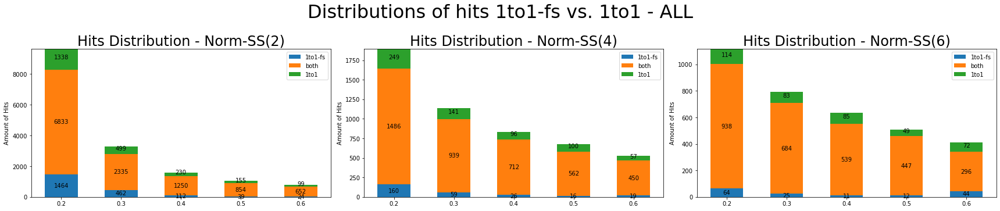

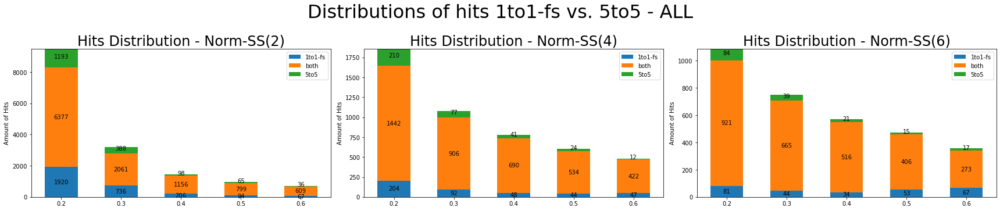

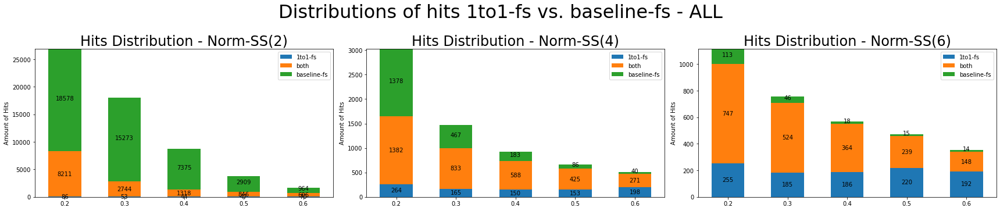

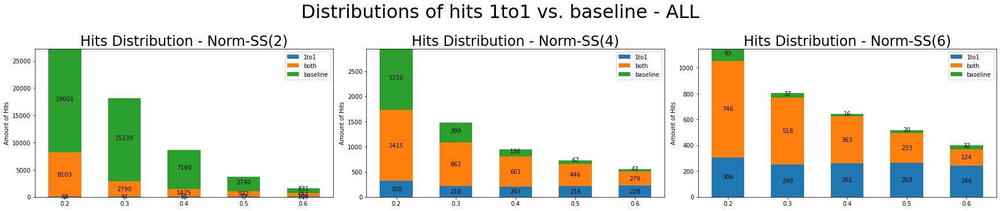

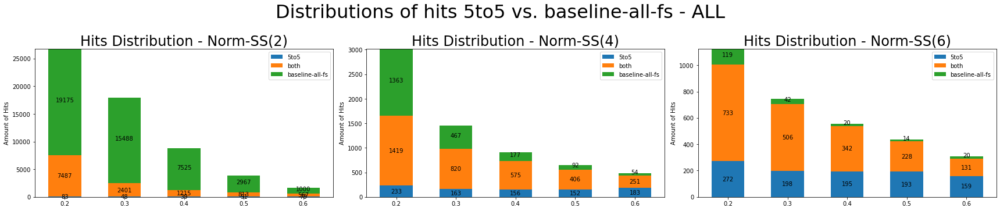

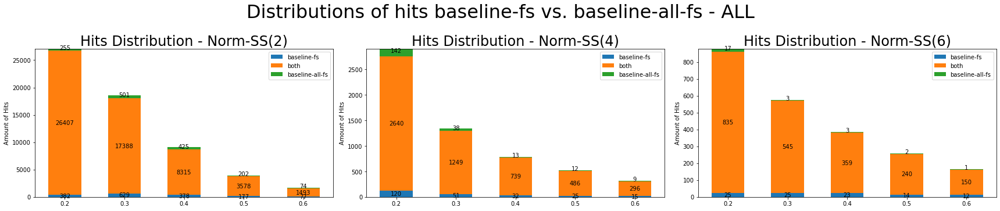

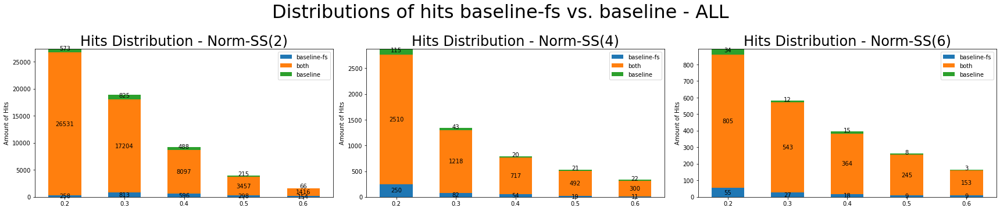

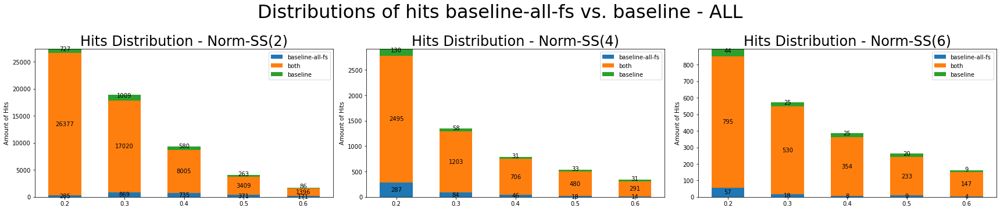

In [18]:
for (mtd_a, mtd_b, chan), cur_cs in cs.items():
    try:
        plot_complementary(chan, f'{mtd_names[mtd_a]} vs. {mtd_names[mtd_b]} - {chan}', cur_cs, method_a=mtd_names[mtd_a],method_b=mtd_names[mtd_b])
    except:
        print('Problem with', f'{mtd_names[mtd_a]} vs. {mtd_names[mtd_b]} - {chan}')

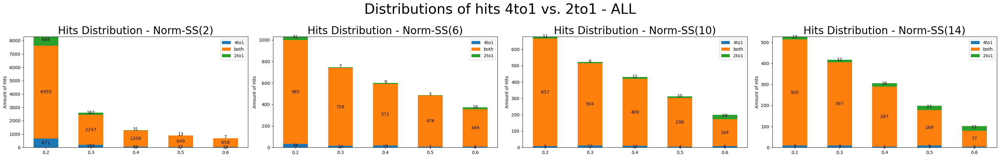

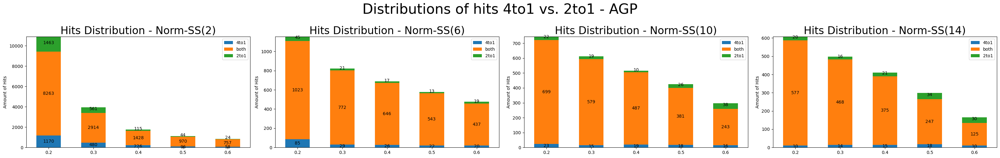

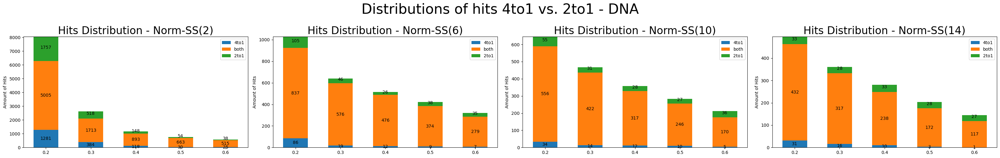

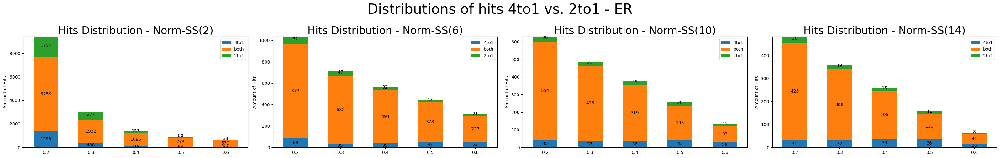

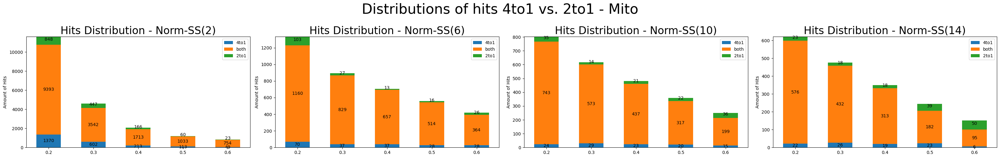

...

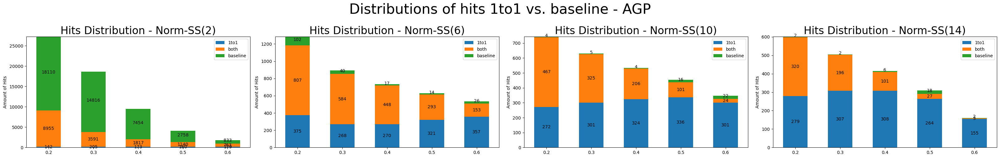

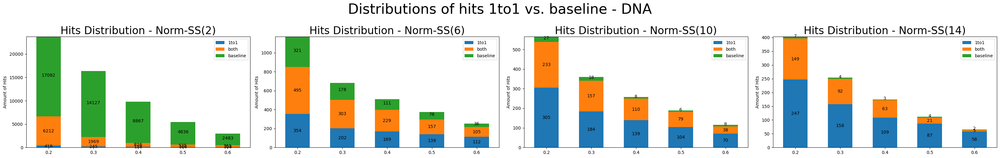

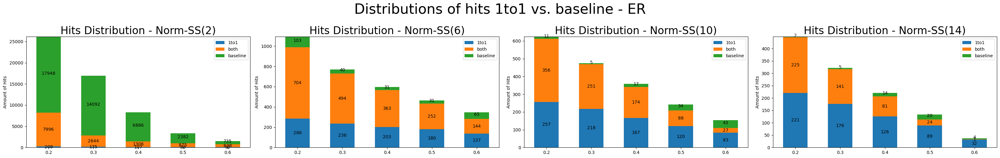

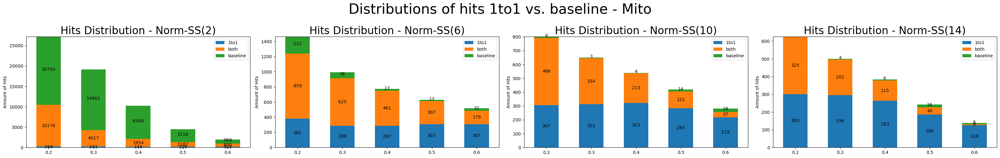

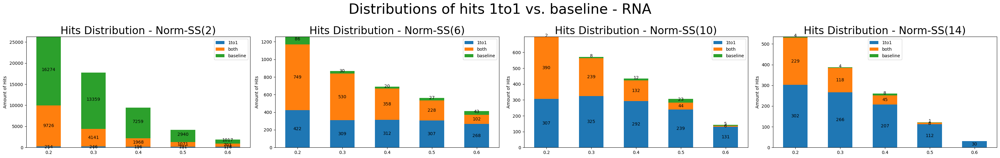

In [42]:
for (mtd_a, mtd_b, chan), cur_cs in cs.items():
    plot_complementary(chan, f'{mtd_names[mtd_a]} vs. {mtd_names[mtd_b]} - {chan}', cur_cs, method_a=mtd_names[mtd_a],method_b=mtd_names[mtd_b])

## Plot Sensitivity

### Plot scater on diagonal

In [7]:
# https://stackoverflow.com/questions/22104256/does-matplotlib-have-a-function-for-drawing-diagonal-lines-in-axis-coordinates
def add_identity(axes, *line_args, **line_kwargs):
    identity, = axes.plot([], [], *line_args, **line_kwargs)
    def callback(axes):
        low_x, high_x = axes.get_xlim()
        low_y, high_y = axes.get_ylim()
        low = max(low_x, low_y)
        high = min(high_x, high_y)
        identity.set_data([low, high], [low, high])
    callback(axes)
    axes.callbacks.connect('xlim_changed', callback)
    axes.callbacks.connect('ylim_changed', callback)
    return axes

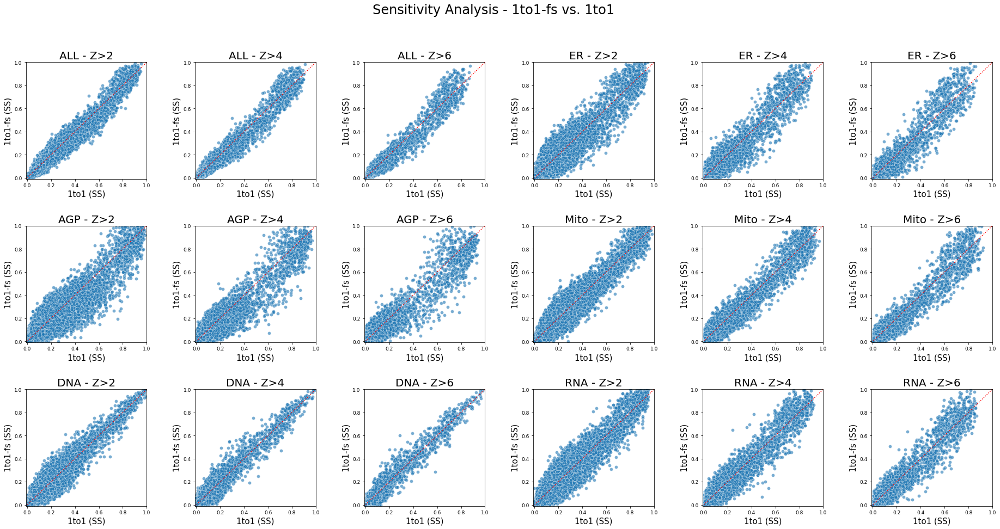

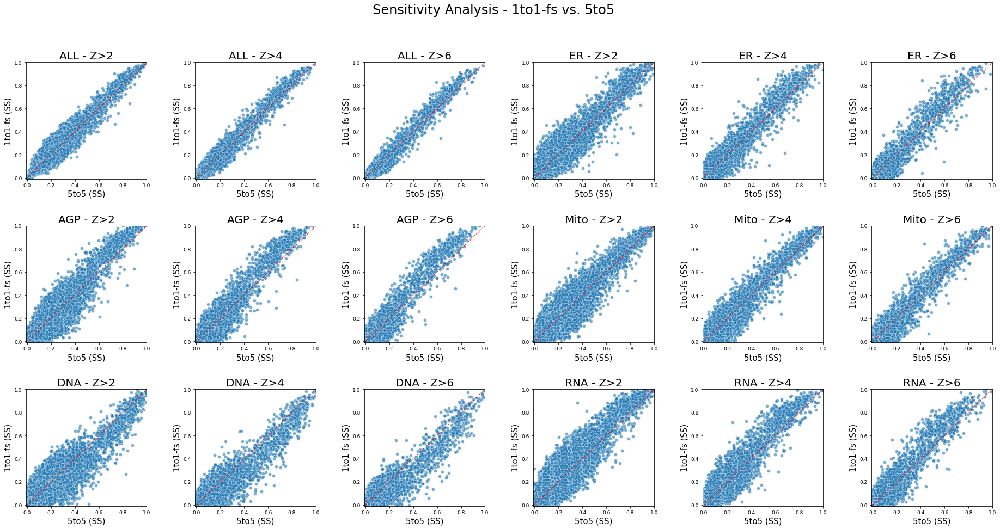

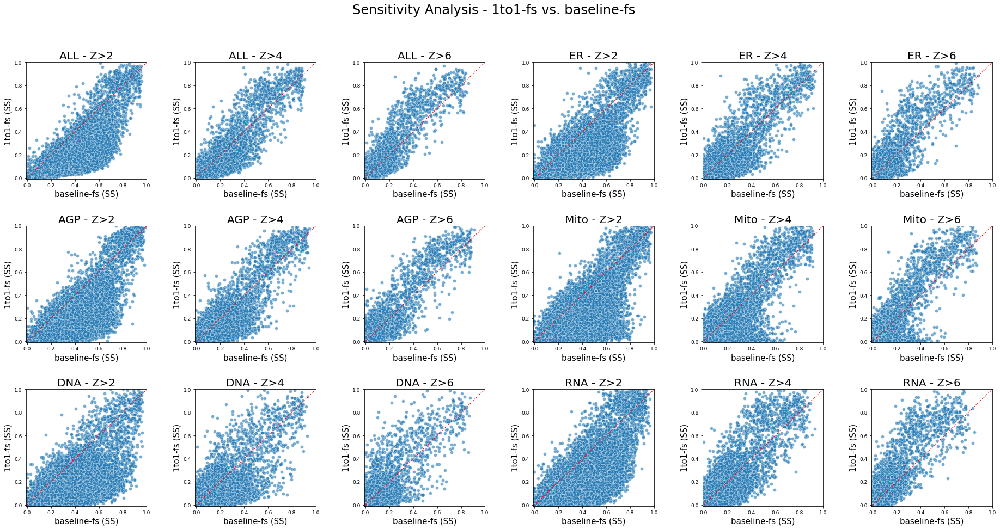

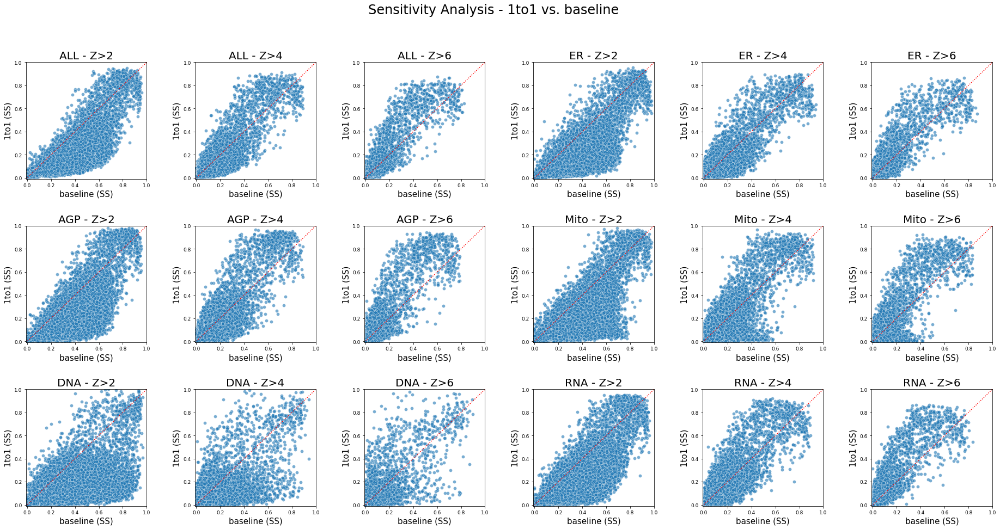

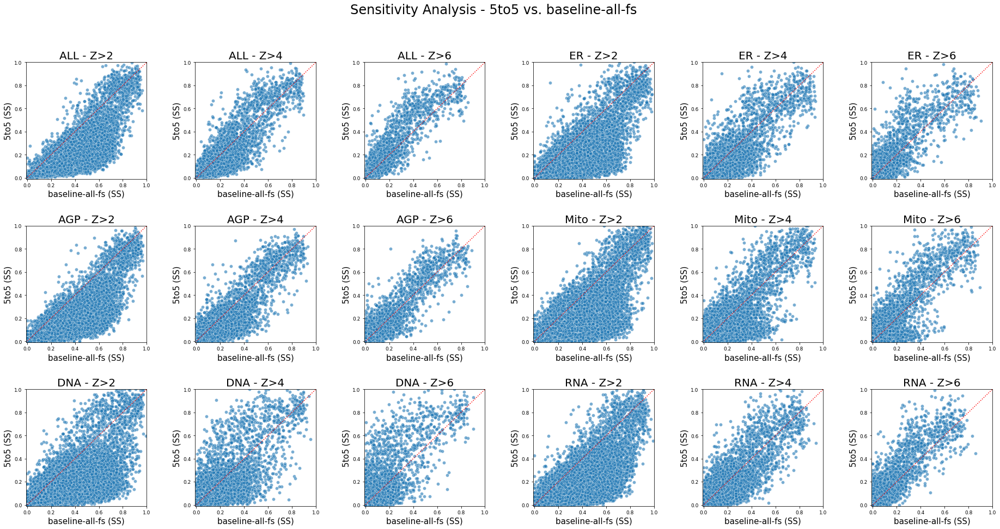

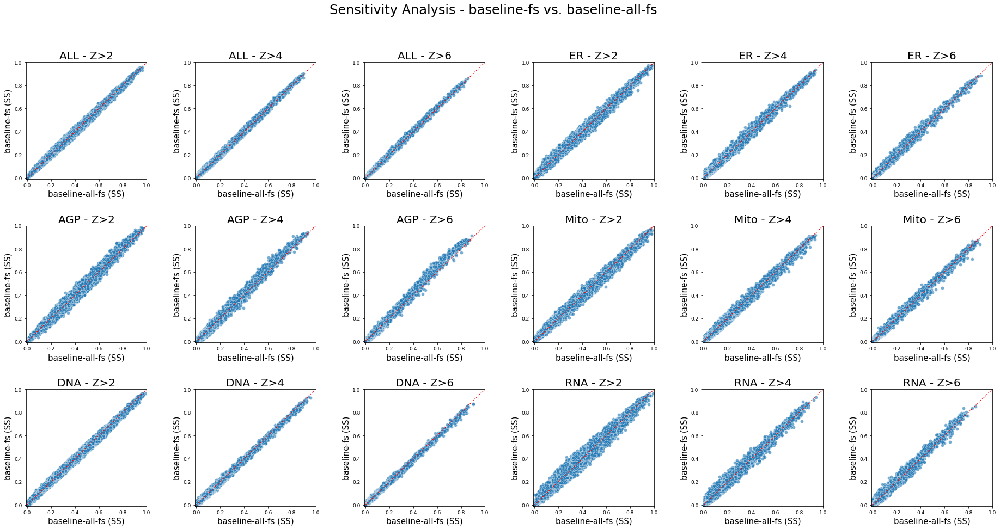

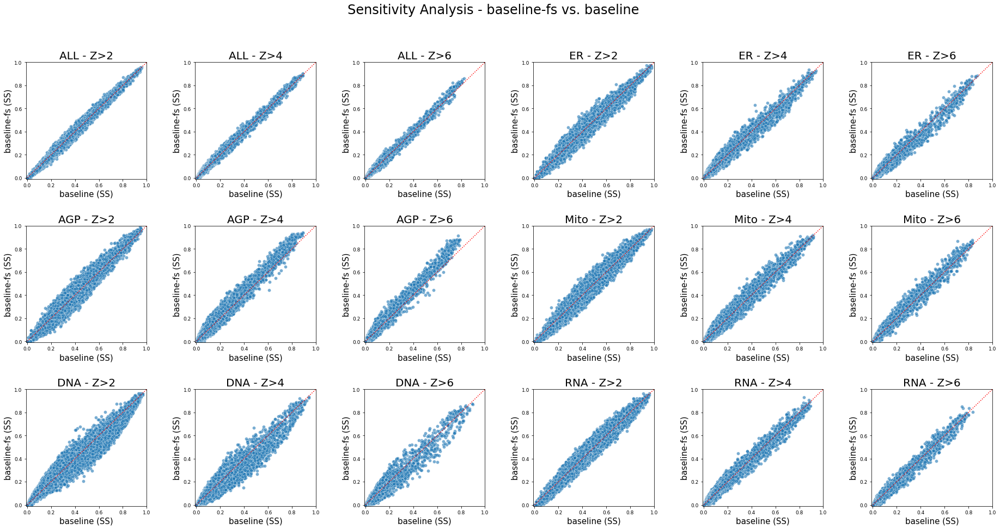

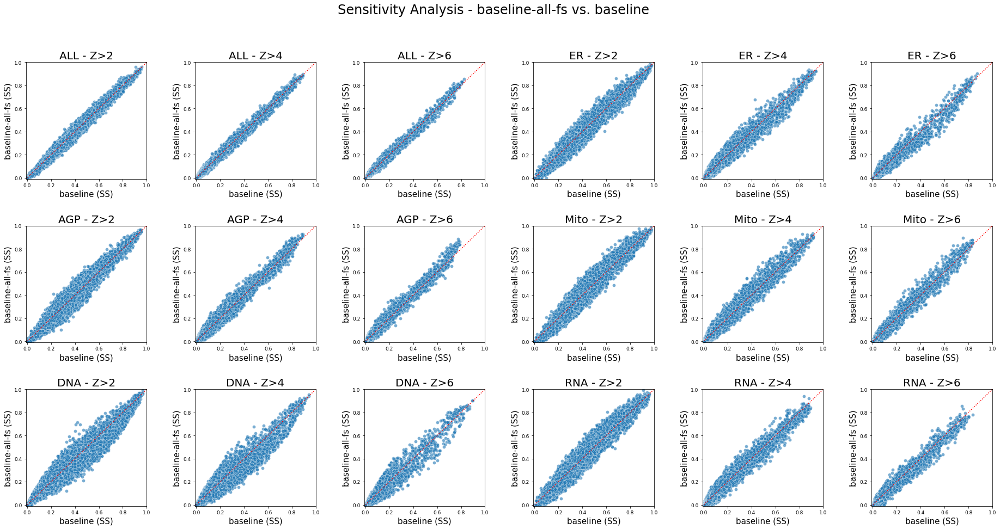

In [8]:
ts = [2,4,6]
nrow = 3
ncol = len(ts)*(len(channels)//nrow)


for mtd_a, mtd_b in combs:
    d={'xlabel':f'{mtd_names[mtd_b]} (SS)', 'ylabel': f'{mtd_names[mtd_a]} (SS)'}
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.3,nrow*5), subplot_kw=d, facecolor='white')
    fig.suptitle(f'Sensitivity Analysis - {mtd_names[mtd_a]} vs. {mtd_names[mtd_b]}', fontsize = 24)
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    
    for i, chan in enumerate(channels):
        joined = ss_scores[mtd_a].join(ss_scores[mtd_b].filter(like=chan, axis=1), how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')

        for j, t in enumerate(ts):
            ax = axs[i%nrow,(i//nrow)*nrow + j]
            ax.set_title(f'{chan} - Z>{t}')

            _ = sns.scatterplot(data=joined, x=f'{chan}_SS_{t}_{mtd_names[mtd_b]}', y=f'{chan}_SS_{t}_{mtd_names[mtd_a]}', alpha=0.6, ax=ax)


            add_identity(ax, color='r', ls=':')


            ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
                             bottom=True, top=False, left=True, right=False)
            ax.tick_params(axis='both', labelsize = 9)
            ax.yaxis.label.set_size(15)
            ax.xaxis.label.set_size(15)
            ax.title.set_size(20)

            ax.set(xlim=(-0.01, 1), ylim=(-0.01, 1))
            
    plt.show()
        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

#         _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/plots/ss-raw-map-no-abs-several-ts.png', format='png')

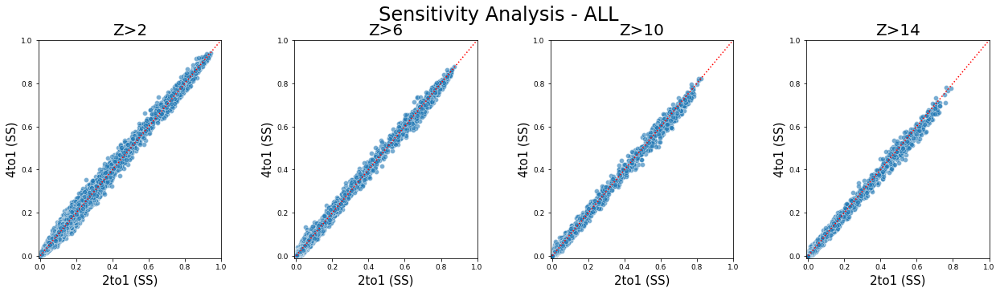

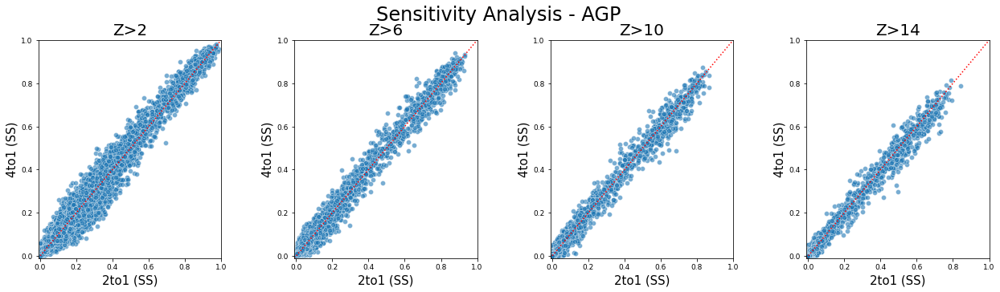

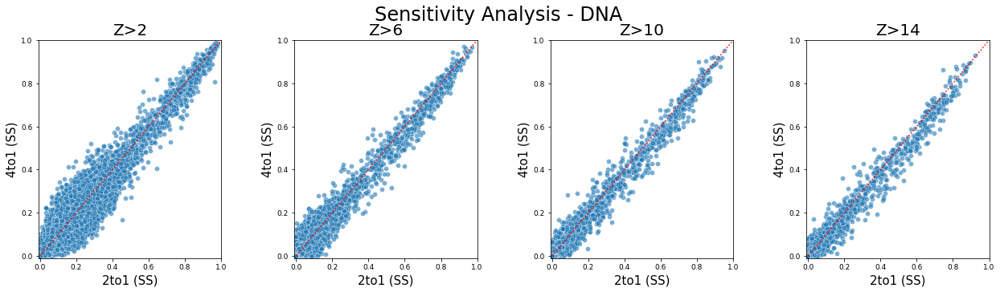

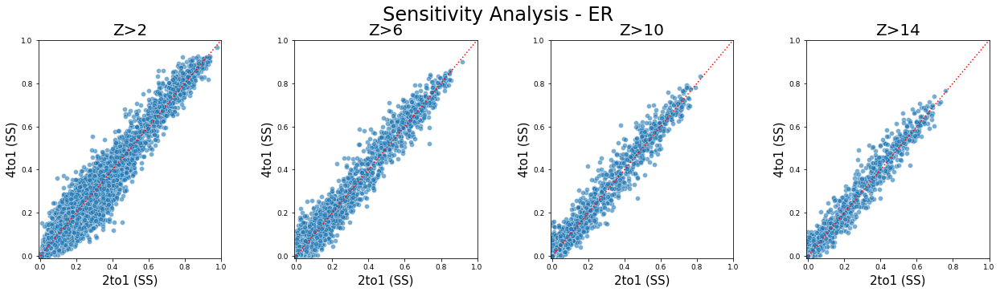

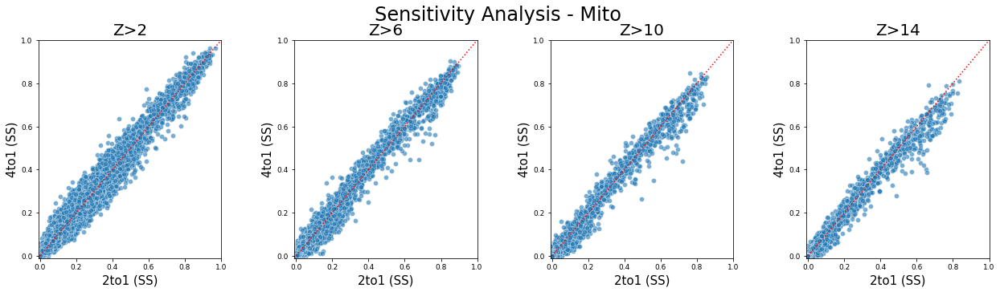

...

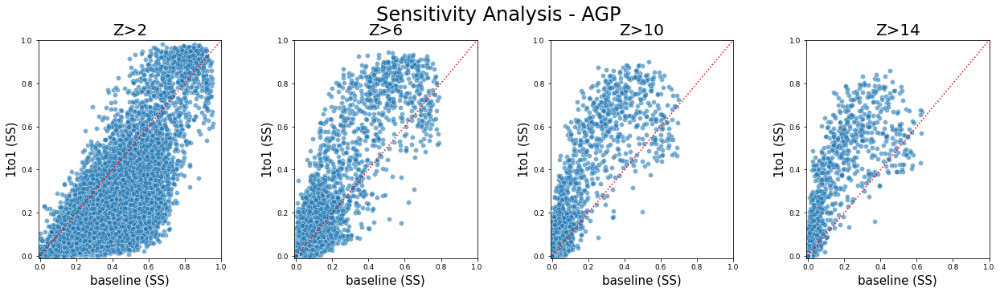

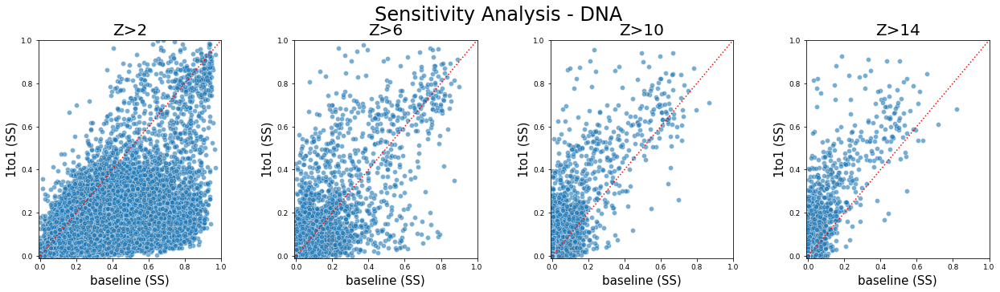

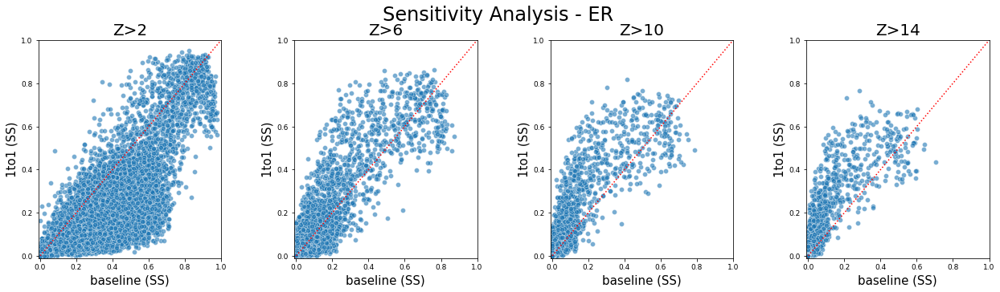

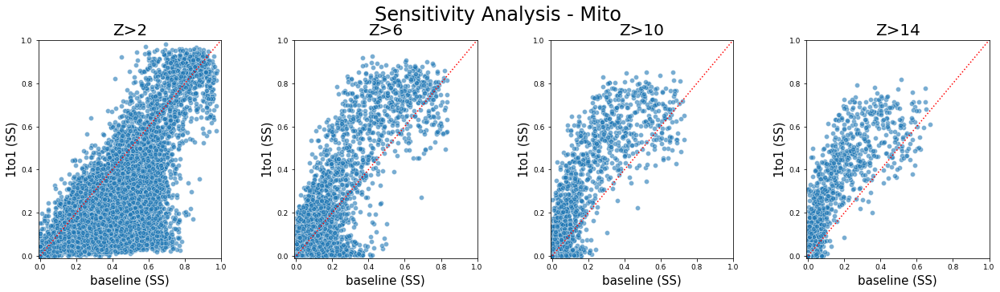

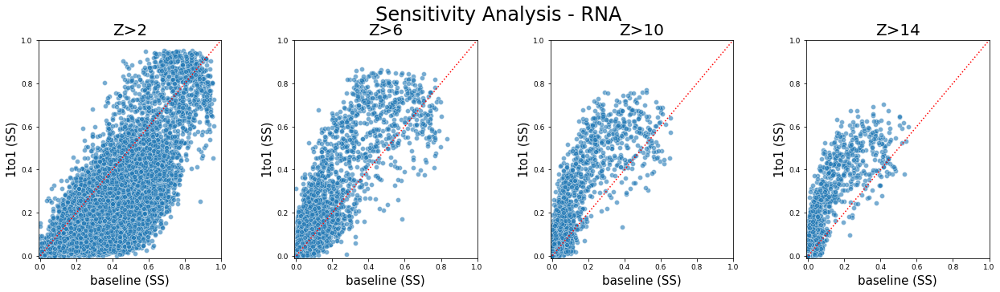

In [16]:
nrow = 1
ncol = 4
ts = [2,6,10,14]

for mtd_a, mtd_b in combinations(ss_scores.keys(), 2):
    d={'xlabel':f'{mtd_names[mtd_b]} (SS)', 'ylabel': f'{mtd_names[mtd_a]} (SS)'}
    for chan in channels:
        joined = ss_scores[mtd_a].join(ss_scores[mtd_b].filter(like=chan, axis=1), how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
        joined = joined / len(cols[chan])

        fig, ax = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.3,nrow*5), subplot_kw=d, facecolor='white')
        fig.suptitle(f'Sensitivity Analysis - {chan}', fontsize = 24, y = 1)
        fig.subplots_adjust(hspace=0.4, wspace=0.4)

        for i, t in enumerate(ts):
            ax[i].set_title(f'Z>{t}')

            _ = sns.scatterplot(data=joined, x=f'{chan}_SS_{t}_{mtd_names[mtd_b]}', y=f'{chan}_SS_{t}_{mtd_names[mtd_a]}', alpha=0.6, ax=ax[i])


            add_identity(ax[i], color='r', ls=':')


            ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
                             bottom=True, top=False, left=True, right=False)
            ax[i].tick_params(axis='both', labelsize = 9)
            ax[i].yaxis.label.set_size(15)
            ax[i].xaxis.label.set_size(15)
            ax[i].title.set_size(20)

            ax[i].set(xlim=(-0.01, 1), ylim=(-0.01, 1))
            
        plt.show()

        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

#         _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/plots/ss-raw-map-no-abs-several-ts.png', format='png')

### Plot Violin plot

In [9]:
ss_scores.keys()

dict_keys([111, 11, 55, 0, 5, 1])

In [10]:
results = []
for method in ss_scores.keys():
    for chan in channels:
        res = (ss_scores[method].filter(like=f'{chan}_SS', axis=1).rename(lambda x: x.split('_')[-1], axis=1)).melt(var_name='Threshold', value_name='SS')
        res['Channel'] = chan
        res['Method'] = method
        results.append(res)

In [11]:
data = pd.concat(results)
data

,Threshold,SS,Channel,Method
0,2,0.115385,ALL,111
1,2,0.065089,ALL,111
2,2,0.169379,ALL,111
3,2,0.050296,ALL,111
4,2,0.170118,ALL,111
...,...,...,...,...
578317,20,0.000000,RNA,1
578318,20,0.000000,RNA,1
578319,20,0.000000,RNA,1
578320,20,0.000000,RNA,1


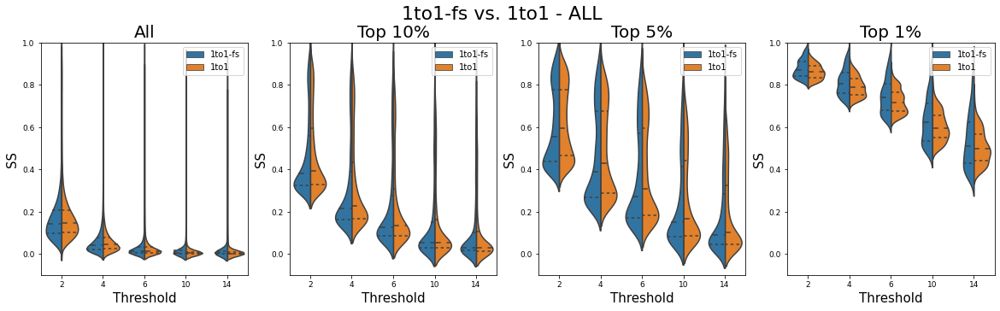

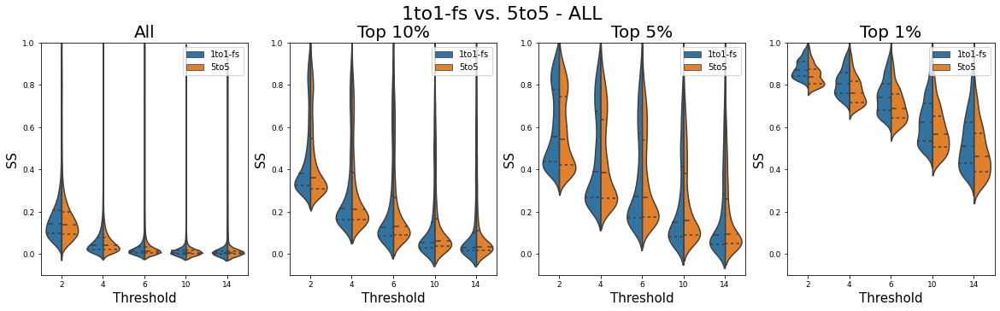

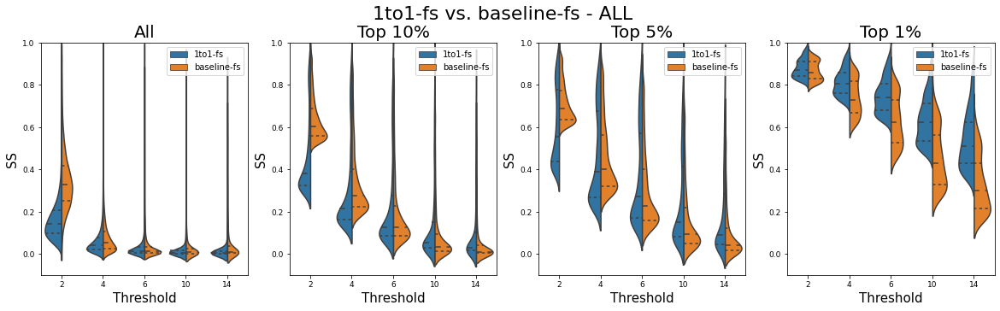

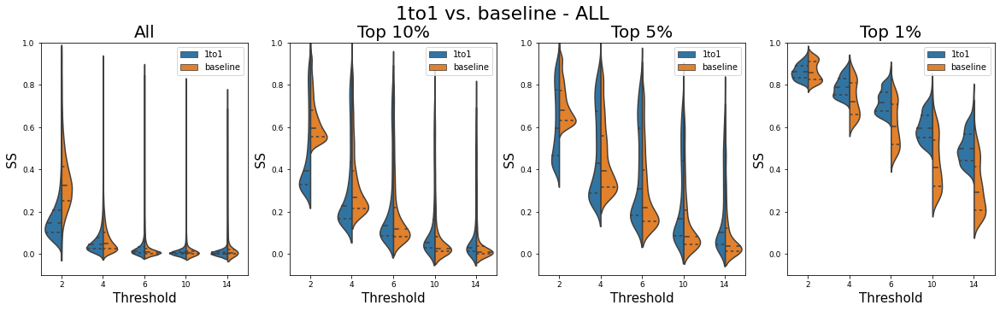

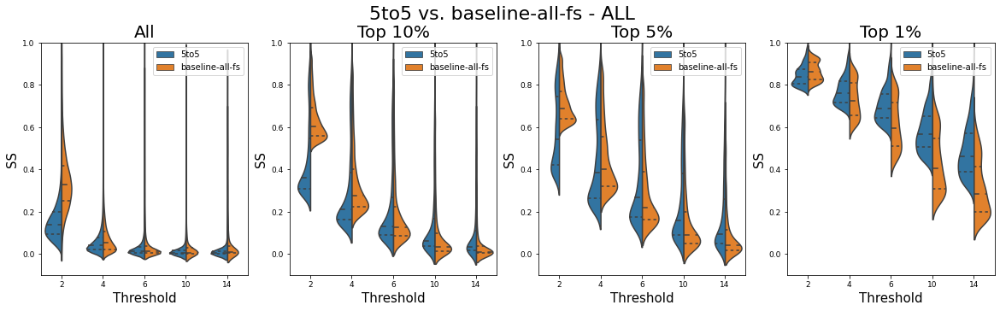

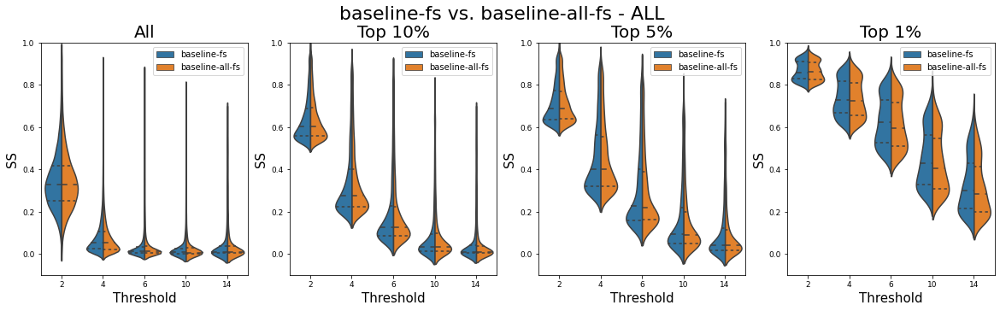

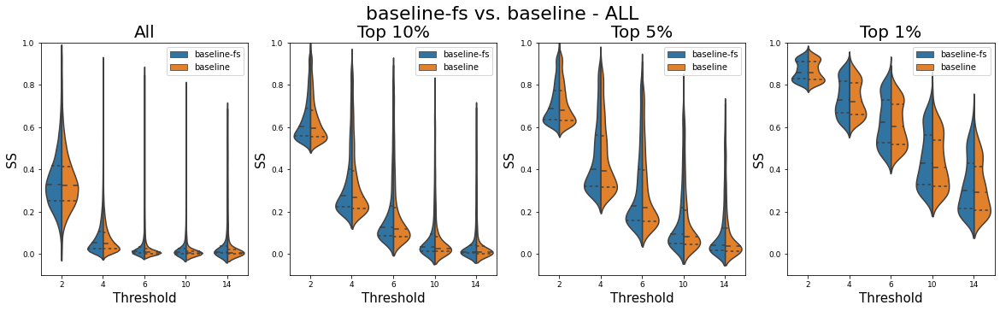

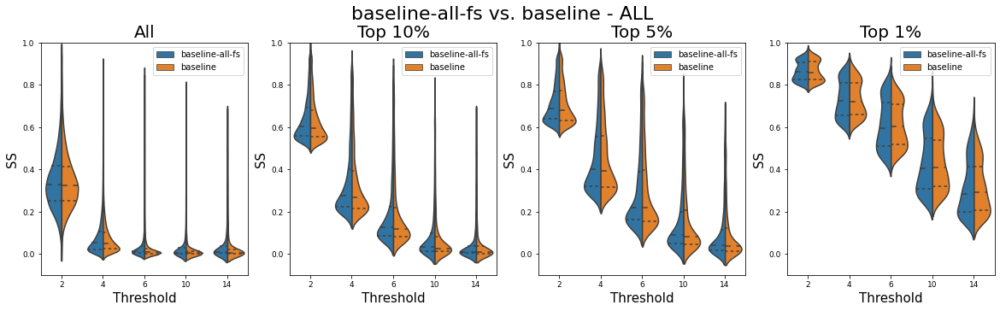

In [12]:
percentiles = [0,0.9,0.95,0.99]

nrow = 1
ncol = len(percentiles)

d={'xlabel':"Threshold", 'ylabel':"SS"}
titles = ['All', 'Top 10%', 'Top 5%','Top 1%']

chan = 'ALL'




for mtd_a, mtd_b in combs:
    cur_data = data[data.Method.isin([mtd_a,mtd_b])]
    cur_data = cur_data[cur_data.Threshold.isin([str(i) for i in [2, 4, 6, 10, 14]])]
    cur_data.Method = cur_data.Method.replace(mtd_names)
    cur_data = cur_data[cur_data.Channel==chan]
    thresholds = cur_data.Threshold.unique()
    methods = cur_data.Method.unique()

    fig, ax = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5,nrow*5), subplot_kw=d, facecolor='white')
    fig.suptitle(f'{mtd_names[mtd_a]} vs. {mtd_names[mtd_b]} - {chan}', fontsize=22, y=1)


    for i, p in enumerate(percentiles):

        data_outliers = pd.DataFrame()
        for t in thresholds:
            data_t = cur_data[cur_data['Threshold']==t]
            for j, m in enumerate(methods):
                # print(m)
                data_m = data_t[data_t['Method']==m]
                # data_m.head()
                quantile = data_m['SS'].quantile(p)
                # print(quantile)
                data_m_outliers = data_m[data_m['SS']>quantile]  
                data_outliers = pd.concat([data_outliers, data_m_outliers])

        # _ = sns.boxplot(data=data_outliers, x='Threshold', y='SS',hue='Method', palette="Set2",ax=ax[i])
        _ = sns.violinplot(data=data_outliers, x='Threshold', y='SS', hue='Method', ax=ax[i], split=True, inner='quartile')
        del data_outliers

        ax[i].set_title(titles[i])
        ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
                         bottom=True, top=False, left=True, right=False)
        ax[i].tick_params(axis='both', labelsize = 9)
        ax[i].yaxis.label.set_size(15)
        ax[i].xaxis.label.set_size(15)
        ax[i].title.set_size(20)
        ax[i].legend(loc='upper right')

        ax[i].set(ylim=(-0.1, 1))
        
    plt.show()
        
    

#     _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]} - ALL.png', format='png')
#     _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]} - ALL.eps', format='eps')


## Plot Sensitivity Difference

### With (0,0)

In [ ]:
diff = {}
ts = range(2,21)
for mtd_a, mtd_b in combinations(ss_scores.keys(), 2):
    joined = ss_scores[mtd_a].join(ss_scores[mtd_b], how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
    for chan in channels:
        diffs = []
        for t in ts:
            met_a = joined[f'{chan}_SS_{t}_{mtd_names[mtd_a]}']
            met_b = joined[f'{chan}_SS_{t}_{mtd_names[mtd_b]}']
            # dif = (met_a - met_b)/len(cols[chan])
            dif.name = t
            diffs.append(dif)
        
        all_diffs = pd.concat(diffs, axis=1)
        all_diffs = all_diffs.melt(var_name='Threshold', value_name='Difference')
        diff[(mtd_a, mtd_b, chan)] = all_diffs

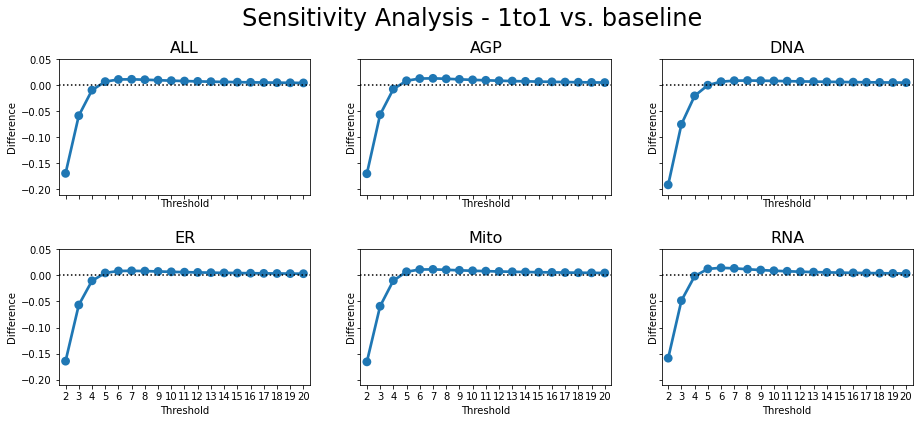

In [29]:
nrow = 2
ncol = 3
d={} #{'xlabel':"same-organelle (SS)", 'ylabel':"organelle-organelle (SS)"}

for mtd_a, mtd_b in combinations(ss_scores.keys(), 2):
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.1,nrow*3), subplot_kw=d, facecolor='white', sharey=True, sharex=True)
    fig.suptitle(f'Sensitivity Analysis - {mtd_names[mtd_a]} vs. {mtd_names[mtd_b]}', fontsize = 24, y = 1)
    fig.subplots_adjust(hspace=0.4, wspace=0.2)

    for i, chan in enumerate(channels):
        ax = axs[i//ncol, i%ncol]
        
        sns.pointplot(data=diff[(mtd_a, mtd_b, chan)], x='Threshold', y='Difference', ax=ax)
        ax.set_title(f'{chan}', fontsize=16)
        ax.axhline(0, linestyle=':', color='k')
        if mtd_b == 1:
            ax.set(ylim=(-0.21, 0.051))
        else:
            ax.set(ylim=(-0.016, 0.011))
        
    plt.show()



#         ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
#                          bottom=True, top=False, left=True, right=False)
#         ax[i].tick_params(axis='both', labelsize = 9)
#         ax[i].yaxis.label.set_size(15)
#         ax[i].xaxis.label.set_size(15)
#         ax[i].title.set_size(20)

        # ax[i].set(xlim=(-0.01, 1), ylim=(-0.01, 1))

        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

#         _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/ss_mas/plots/ss-raw-map-no-abs-several-ts.png', format='png')

### Without (0, 0)

In [13]:
diff_non_zero = {}
ts = range(2,21)
for mtd_a, mtd_b in combs:
    joined = ss_scores[mtd_a].join(ss_scores[mtd_b], how='right', lsuffix=f'_{mtd_names[mtd_a]}', rsuffix=f'_{mtd_names[mtd_b]}')
    for chan in channels:
        
        
        diffs = []
        for t in ts:
            met_a = joined[f'{chan}_SS_{t}_{mtd_names[mtd_a]}']
            met_b = joined[f'{chan}_SS_{t}_{mtd_names[mtd_b]}']
            mask = (met_a + met_b) != 0
            dif = (met_a - met_b)[mask]#/len(cols[chan])
            dif.name = t
            diffs.append(dif)
        
        all_diffs = pd.concat(diffs, axis=1)
        all_diffs = all_diffs.melt(var_name='Threshold', value_name='Difference')
        diff_non_zero[(mtd_a, mtd_b, chan)] = all_diffs

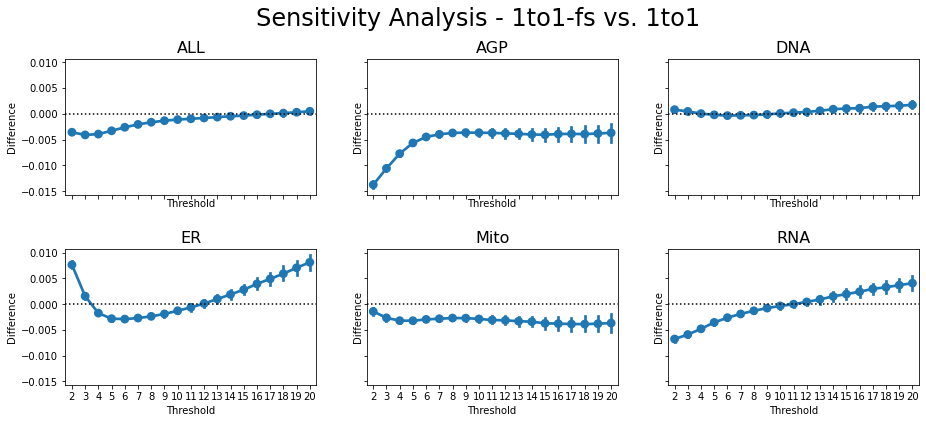

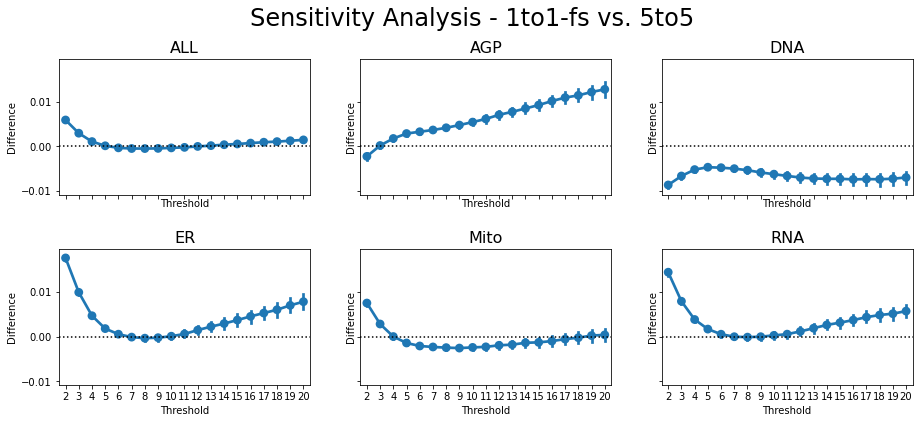

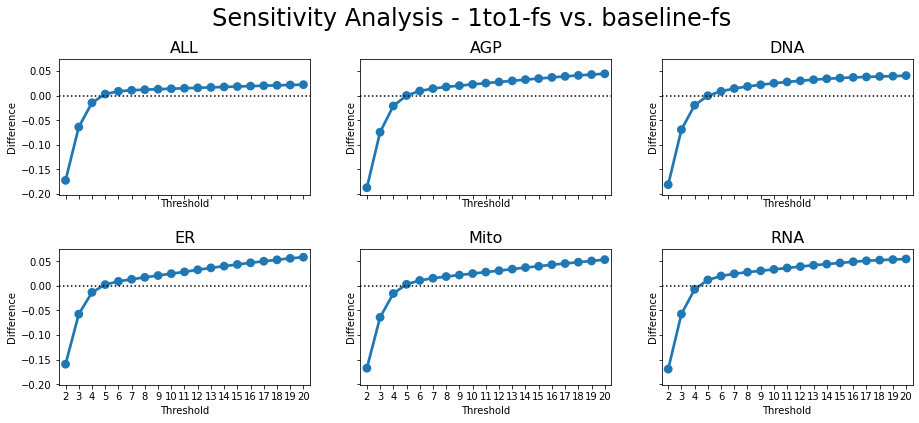

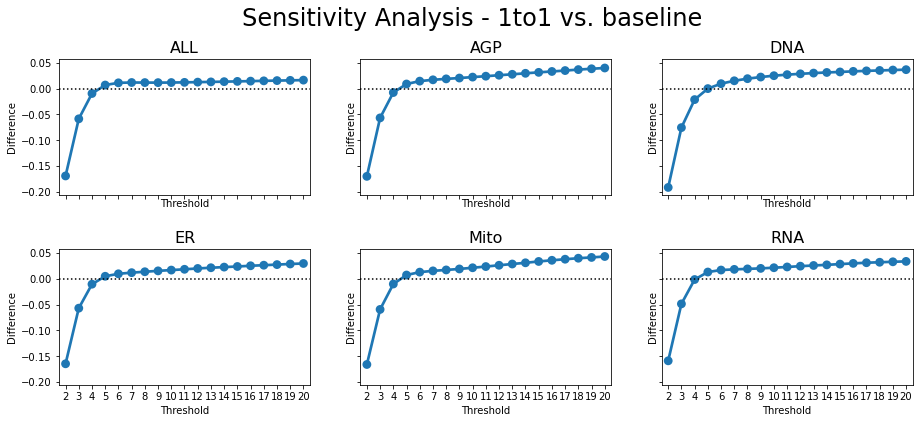

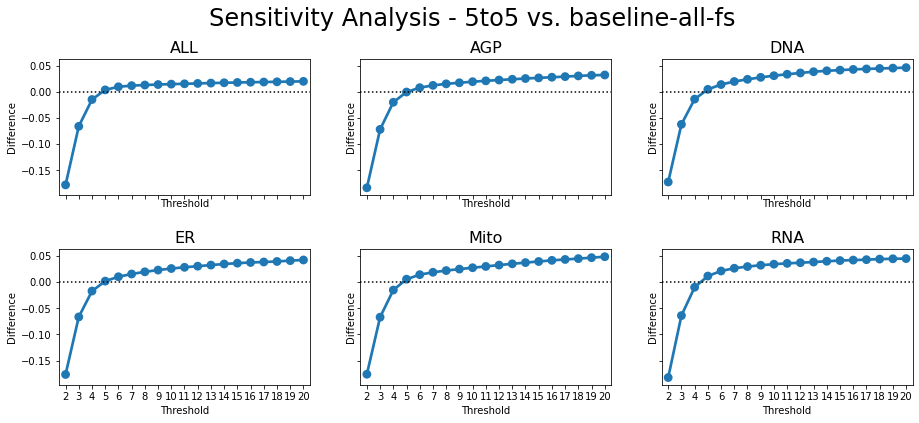

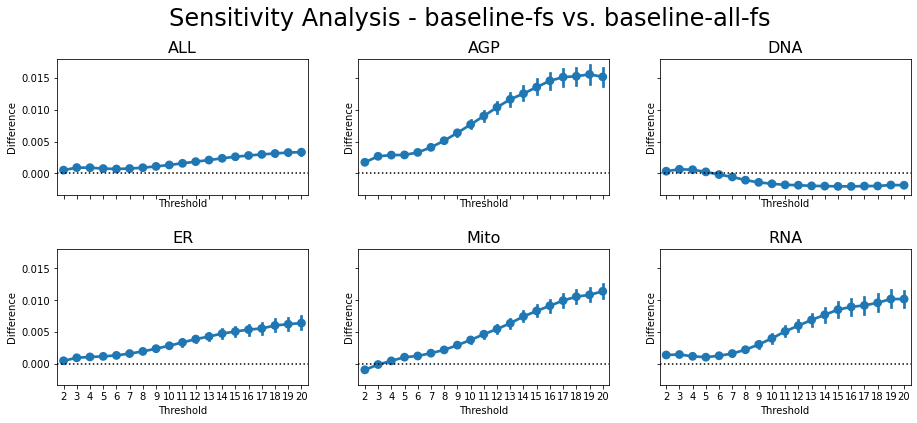

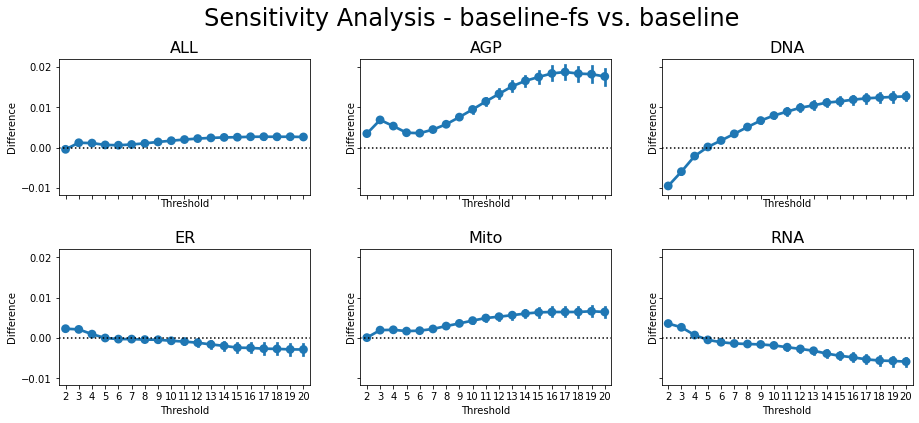

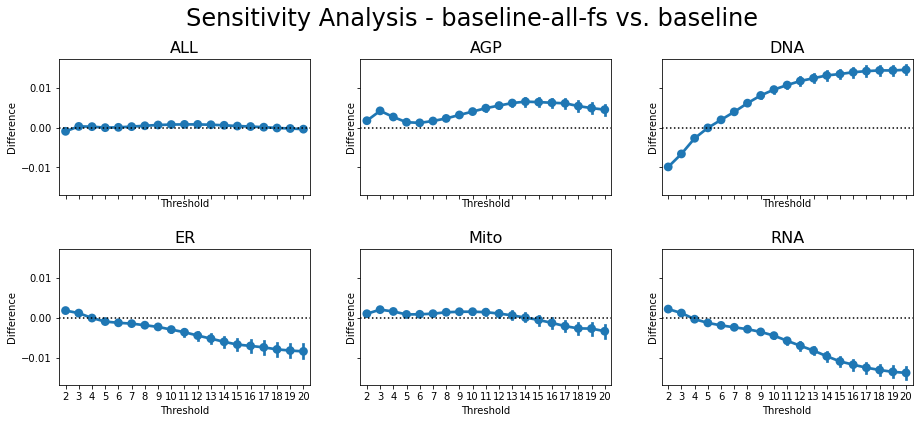

In [14]:
nrow = 2
ncol = 3
d={} #{'xlabel':"same-organelle (SS)", 'ylabel':"organelle-organelle (SS)"}

for mtd_a, mtd_b in combs:
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(ncol*5.1,nrow*3), subplot_kw=d, facecolor='white', sharey=True, sharex=True)
    fig.suptitle(f'Sensitivity Analysis - {mtd_names[mtd_a]} vs. {mtd_names[mtd_b]}', fontsize = 24, y = 1)
    fig.subplots_adjust(hspace=0.4, wspace=0.2)

    for i, chan in enumerate(channels):
        ax = axs[i//ncol, i%ncol]
        
        sns.pointplot(data=diff_non_zero[(mtd_a, mtd_b, chan)], x='Threshold', y='Difference', ax=ax)
        ax.set_title(f'{chan}', fontsize=16)
        ax.axhline(0, linestyle=':', color='k')
        # if mtd_b == 1:
        #     ax.set(ylim=(-0.21, 0.051))
        # else:
        #     ax.set(ylim=(-0.016, 0.011))
        
    plt.show()



#         ax[i].tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False,
#                          bottom=True, top=False, left=True, right=False)
#         ax[i].tick_params(axis='both', labelsize = 9)
#         ax[i].yaxis.label.set_size(15)
#         ax[i].xaxis.label.set_size(15)
#         ax[i].title.set_size(20)



        # _ = fig.legend(symbols, zscores.keys(), markerscale=1.2, loc='center right')#, fontsize='xx-large')

    # _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity_diff/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]}.png', format='png')
    # _ = fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/sensitivity_diff/{mtd_names[mtd_a]} vs {mtd_names[mtd_b]}.eps', format='eps')